# Afriat

In [1]:
scan=0.13

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: t07k3iyw
Name: star-cruiser-107
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/t07k3iyw
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-t07k3iyw/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2565,3310,9368
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2565,2581,1653,3429,1619,3396
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4470,10773
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 640,799,2371
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 640,621,455,861,430,803
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1114,2696
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:26:15, 14.65s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:26:15, 14.65s/it, v_num=yw_1, total_loss_train=3.69e+3, kl_local_train=53.8]

Epoch 2/600:   0%|          | 1/600 [00:14<2:26:15, 14.65s/it, v_num=yw_1, total_loss_train=3.69e+3, kl_local_train=53.8]

Epoch 2/600:   0%|          | 2/600 [00:28<2:20:54, 14.14s/it, v_num=yw_1, total_loss_train=3.69e+3, kl_local_train=53.8]

Epoch 2/600:   0%|          | 2/600 [00:28<2:20:54, 14.14s/it, v_num=yw_1, total_loss_train=3.22e+3, kl_local_train=80]  

Epoch 3/600:   0%|          | 2/600 [00:28<2:20:54, 14.14s/it, v_num=yw_1, total_loss_train=3.22e+3, kl_local_train=80]

Epoch 3/600:   0%|          | 3/600 [00:42<2:18:36, 13.93s/it, v_num=yw_1, total_loss_train=3.22e+3, kl_local_train=80]

Epoch 3/600:   0%|          | 3/600 [00:42<2:18:36, 13.93s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=82]

Epoch 4/600:   0%|          | 3/600 [00:42<2:18:36, 13.93s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=82]

Epoch 4/600:   1%|          | 4/600 [00:55<2:17:04, 13.80s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=82]

Epoch 4/600:   1%|          | 4/600 [00:55<2:17:04, 13.80s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=79.4]

Epoch 5/600:   1%|          | 4/600 [00:55<2:17:04, 13.80s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=79.4]

Epoch 5/600:   1%|          | 5/600 [01:09<2:17:01, 13.82s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=79.4]

Epoch 5/600:   1%|          | 5/600 [01:09<2:17:01, 13.82s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=73.9]

Epoch 6/600:   1%|          | 5/600 [01:10<2:17:01, 13.82s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=73.9]

Epoch 6/600:   1%|          | 6/600 [01:24<2:18:57, 14.04s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=73.9]

Epoch 6/600:   1%|          | 6/600 [01:24<2:18:57, 14.04s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=65, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:24<2:18:57, 14.04s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=65, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:37<2:16:02, 13.77s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=65, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:37<2:16:02, 13.77s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:37<2:16:02, 13.77s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:50<2:13:49, 13.56s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:50<2:13:49, 13.56s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:50<2:13:49, 13.56s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:03<2:12:02, 13.41s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:03<2:12:02, 13.41s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=26, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]  

Epoch 10/600:   2%|▏         | 9/600 [02:03<2:12:02, 13.41s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=26, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:16<2:10:57, 13.32s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=26, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:16<2:10:57, 13.32s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=25.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:17<2:10:57, 13.32s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=25.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:30<2:13:59, 13.65s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=25.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00757, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:30<2:13:59, 13.65s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449] 

Epoch 12/600:   2%|▏         | 11/600 [02:30<2:13:59, 13.65s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 12/600:   2%|▏         | 12/600 [02:43<2:11:51, 13.45s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 12/600:   2%|▏         | 12/600 [02:43<2:11:51, 13.45s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 13/600:   2%|▏         | 12/600 [02:43<2:11:51, 13.45s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 13/600:   2%|▏         | 13/600 [02:56<2:09:36, 13.25s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 13/600:   2%|▏         | 13/600 [02:56<2:09:36, 13.25s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 14/600:   2%|▏         | 13/600 [02:56<2:09:36, 13.25s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 14/600:   2%|▏         | 14/600 [03:09<2:08:51, 13.19s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 14/600:   2%|▏         | 14/600 [03:09<2:08:51, 13.19s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 15/600:   2%|▏         | 14/600 [03:09<2:08:51, 13.19s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 15/600:   2%|▎         | 15/600 [03:22<2:08:17, 13.16s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 15/600:   2%|▎         | 15/600 [03:22<2:08:17, 13.16s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 16/600:   2%|▎         | 15/600 [03:24<2:08:17, 13.16s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 16/600:   3%|▎         | 16/600 [03:37<2:11:53, 13.55s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.0207, metric_mi|mouse_train=0.0449]

Epoch 16/600:   3%|▎         | 16/600 [03:37<2:11:53, 13.55s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 17/600:   3%|▎         | 16/600 [03:37<2:11:53, 13.55s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 17/600:   3%|▎         | 17/600 [03:50<2:10:15, 13.41s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 17/600:   3%|▎         | 17/600 [03:50<2:10:15, 13.41s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 18/600:   3%|▎         | 17/600 [03:50<2:10:15, 13.41s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 18/600:   3%|▎         | 18/600 [04:03<2:09:08, 13.31s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 18/600:   3%|▎         | 18/600 [04:03<2:09:08, 13.31s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=80.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 19/600:   3%|▎         | 18/600 [04:03<2:09:08, 13.31s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=80.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 19/600:   3%|▎         | 19/600 [04:16<2:08:11, 13.24s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=80.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 19/600:   3%|▎         | 19/600 [04:16<2:08:11, 13.24s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 20/600:   3%|▎         | 19/600 [04:16<2:08:11, 13.24s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 20/600:   3%|▎         | 20/600 [04:29<2:07:50, 13.23s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 20/600:   3%|▎         | 20/600 [04:29<2:07:50, 13.23s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=90.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 21/600:   3%|▎         | 20/600 [04:31<2:07:50, 13.23s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=90.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 21/600:   4%|▎         | 21/600 [04:44<2:11:16, 13.60s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=90.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0712]

Epoch 21/600:   4%|▎         | 21/600 [04:44<2:11:16, 13.60s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=94.6, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927] 

Epoch 22/600:   4%|▎         | 21/600 [04:44<2:11:16, 13.60s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=94.6, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 22/600:   4%|▎         | 22/600 [04:57<2:09:46, 13.47s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=94.6, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 22/600:   4%|▎         | 22/600 [04:57<2:09:46, 13.47s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927] 

Epoch 23/600:   4%|▎         | 22/600 [04:57<2:09:46, 13.47s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 23/600:   4%|▍         | 23/600 [05:10<2:08:30, 13.36s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 23/600:   4%|▍         | 23/600 [05:10<2:08:30, 13.36s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 24/600:   4%|▍         | 23/600 [05:10<2:08:30, 13.36s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 24/600:   4%|▍         | 24/600 [05:23<2:07:18, 13.26s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 24/600:   4%|▍         | 24/600 [05:23<2:07:18, 13.26s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 25/600:   4%|▍         | 24/600 [05:23<2:07:18, 13.26s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 25/600:   4%|▍         | 25/600 [05:36<2:06:32, 13.21s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 25/600:   4%|▍         | 25/600 [05:36<2:06:32, 13.21s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 26/600:   4%|▍         | 25/600 [05:38<2:06:32, 13.21s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 26/600:   4%|▍         | 26/600 [05:51<2:09:51, 13.57s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0927]

Epoch 26/600:   4%|▍         | 26/600 [05:51<2:09:51, 13.57s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109] 

Epoch 27/600:   4%|▍         | 26/600 [05:51<2:09:51, 13.57s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 27/600:   4%|▍         | 27/600 [06:03<2:07:18, 13.33s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 27/600:   4%|▍         | 27/600 [06:03<2:07:18, 13.33s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 28/600:   4%|▍         | 27/600 [06:03<2:07:18, 13.33s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 28/600:   5%|▍         | 28/600 [06:15<2:03:18, 12.93s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 28/600:   5%|▍         | 28/600 [06:15<2:03:18, 12.93s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 29/600:   5%|▍         | 28/600 [06:15<2:03:18, 12.93s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 29/600:   5%|▍         | 29/600 [06:27<1:59:55, 12.60s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 29/600:   5%|▍         | 29/600 [06:27<1:59:55, 12.60s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 30/600:   5%|▍         | 29/600 [06:27<1:59:55, 12.60s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 30/600:   5%|▌         | 30/600 [06:39<1:57:49, 12.40s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=122, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 30/600:   5%|▌         | 30/600 [06:39<1:57:49, 12.40s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 31/600:   5%|▌         | 30/600 [06:40<1:57:49, 12.40s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 31/600:   5%|▌         | 31/600 [06:53<2:00:59, 12.76s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.109]

Epoch 31/600:   5%|▌         | 31/600 [06:53<2:00:59, 12.76s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]  

Epoch 32/600:   5%|▌         | 31/600 [06:53<2:00:59, 12.76s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 32/600 [07:05<1:59:44, 12.65s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 32/600 [07:05<1:59:44, 12.65s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 33/600:   5%|▌         | 32/600 [07:05<1:59:44, 12.65s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 33/600:   6%|▌         | 33/600 [07:18<1:59:00, 12.59s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 33/600:   6%|▌         | 33/600 [07:18<1:59:00, 12.59s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 33/600 [07:18<1:59:00, 12.59s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 34/600 [07:30<1:58:26, 12.56s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 34/600 [07:30<1:58:26, 12.56s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 34/600 [07:30<1:58:26, 12.56s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 35/600 [07:43<1:58:50, 12.62s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 35/600 [07:43<1:58:50, 12.62s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 35/600 [07:44<1:58:50, 12.62s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 36/600 [07:57<2:02:08, 12.99s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 36/600 [07:57<2:02:08, 12.99s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 36/600 [07:57<2:02:08, 12.99s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [08:10<2:02:39, 13.07s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [08:10<2:02:39, 13.07s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▌         | 37/600 [08:10<2:02:39, 13.07s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [08:23<2:03:10, 13.15s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [08:23<2:03:10, 13.15s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 38/600 [08:23<2:03:10, 13.15s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [08:36<2:02:55, 13.15s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [08:36<2:02:55, 13.15s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 40/600:   6%|▋         | 39/600 [08:36<2:02:55, 13.15s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:50<2:04:49, 13.37s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:50<2:04:49, 13.37s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122] 

Epoch 41/600:   7%|▋         | 40/600 [08:52<2:04:49, 13.37s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [09:05<2:08:00, 13.74s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [09:05<2:08:00, 13.74s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|▋         | 41/600 [09:05<2:08:00, 13.74s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|▋         | 42/600 [09:18<2:06:35, 13.61s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|▋         | 42/600 [09:18<2:06:35, 13.61s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=97.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|▋         | 42/600 [09:18<2:06:35, 13.61s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=97.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|▋         | 43/600 [09:31<2:04:57, 13.46s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=97.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|▋         | 43/600 [09:31<2:04:57, 13.46s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124] 

Epoch 44/600:   7%|▋         | 43/600 [09:31<2:04:57, 13.46s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|▋         | 44/600 [09:44<2:03:32, 13.33s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|▋         | 44/600 [09:44<2:03:32, 13.33s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 45/600:   7%|▋         | 44/600 [09:44<2:03:32, 13.33s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|▊         | 45/600 [09:58<2:04:42, 13.48s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|▊         | 45/600 [09:58<2:04:42, 13.48s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=97.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|▊         | 45/600 [10:00<2:04:42, 13.48s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=97.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|▊         | 46/600 [10:12<2:06:33, 13.71s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=97.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|▊         | 46/600 [10:12<2:06:33, 13.71s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 47/600:   8%|▊         | 46/600 [10:12<2:06:33, 13.71s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 47/600:   8%|▊         | 47/600 [10:25<2:04:26, 13.50s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 47/600:   8%|▊         | 47/600 [10:25<2:04:26, 13.50s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 48/600:   8%|▊         | 47/600 [10:25<2:04:26, 13.50s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 48/600:   8%|▊         | 48/600 [10:38<2:02:48, 13.35s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 48/600:   8%|▊         | 48/600 [10:38<2:02:48, 13.35s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 49/600:   8%|▊         | 48/600 [10:38<2:02:48, 13.35s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 49/600:   8%|▊         | 49/600 [10:51<2:01:43, 13.26s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 49/600:   8%|▊         | 49/600 [10:51<2:01:43, 13.26s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]  

Epoch 50/600:   8%|▊         | 49/600 [10:51<2:01:43, 13.26s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 50/600:   8%|▊         | 50/600 [11:04<2:00:41, 13.17s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 50/600:   8%|▊         | 50/600 [11:04<2:00:41, 13.17s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 51/600:   8%|▊         | 50/600 [11:06<2:00:41, 13.17s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 51/600:   8%|▊         | 51/600 [11:19<2:03:47, 13.53s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.126]

Epoch 51/600:   8%|▊         | 51/600 [11:19<2:03:47, 13.53s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 52/600:   8%|▊         | 51/600 [11:19<2:03:47, 13.53s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|▊         | 52/600 [11:32<2:02:13, 13.38s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=98.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|▊         | 52/600 [11:32<2:02:13, 13.38s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▊         | 52/600 [11:32<2:02:13, 13.38s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▉         | 53/600 [11:45<2:01:01, 13.27s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=97.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▉         | 53/600 [11:45<2:01:01, 13.27s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=96.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 53/600 [11:45<2:01:01, 13.27s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=96.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 54/600 [11:58<2:00:07, 13.20s/it, v_num=yw_1, total_loss_train=3.21e+3, kl_local_train=96.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 54/600 [11:58<2:00:07, 13.20s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=95.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129] 

Epoch 55/600:   9%|▉         | 54/600 [11:58<2:00:07, 13.20s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=95.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 55/600 [12:11<1:59:11, 13.12s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=95.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 55/600 [12:11<1:59:11, 13.12s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 55/600 [12:12<1:59:11, 13.12s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 56/600 [12:25<2:02:14, 13.48s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 56/600 [12:25<2:02:14, 13.48s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=93.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:   9%|▉         | 56/600 [12:25<2:02:14, 13.48s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=93.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [12:38<2:00:50, 13.35s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=93.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [12:38<2:00:50, 13.35s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 57/600 [12:38<2:00:50, 13.35s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [12:51<1:59:39, 13.25s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [12:51<1:59:39, 13.25s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=92.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 58/600 [12:51<1:59:39, 13.25s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=92.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [13:04<1:59:24, 13.24s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=92.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [13:04<1:59:24, 13.24s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=92, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]  

Epoch 60/600:  10%|▉         | 59/600 [13:04<1:59:24, 13.24s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=92, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [13:18<2:00:04, 13.34s/it, v_num=yw_1, total_loss_train=3.2e+3, kl_local_train=92, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [13:18<2:00:04, 13.34s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=91.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 60/600 [13:19<2:00:04, 13.34s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=91.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [13:32<2:02:08, 13.60s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=91.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [13:32<2:02:08, 13.60s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=89.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|█         | 61/600 [13:32<2:02:08, 13.60s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=89.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|█         | 62/600 [13:45<2:00:57, 13.49s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=89.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|█         | 62/600 [13:45<2:00:57, 13.49s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=88.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|█         | 62/600 [13:45<2:00:57, 13.49s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=88.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|█         | 63/600 [13:59<1:59:56, 13.40s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=88.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|█         | 63/600 [13:59<1:59:56, 13.40s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]  

Epoch 64/600:  10%|█         | 63/600 [13:59<1:59:56, 13.40s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|█         | 64/600 [14:12<1:59:19, 13.36s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|█         | 64/600 [14:12<1:59:19, 13.36s/it, v_num=yw_1, total_loss_train=3187.75, kl_local_train=87.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|█         | 64/600 [14:12<1:59:19, 13.36s/it, v_num=yw_1, total_loss_train=3187.75, kl_local_train=87.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|█         | 65/600 [14:26<1:59:54, 13.45s/it, v_num=yw_1, total_loss_train=3187.75, kl_local_train=87.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|█         | 65/600 [14:26<1:59:54, 13.45s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|█         | 65/600 [14:27<1:59:54, 13.45s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|█         | 66/600 [14:40<2:02:11, 13.73s/it, v_num=yw_1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|█         | 66/600 [14:40<2:02:11, 13.73s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=85.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 66/600 [14:40<2:02:11, 13.73s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=85.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 67/600 [14:53<1:59:58, 13.50s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=85.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 67/600 [14:53<1:59:58, 13.50s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█         | 67/600 [14:53<1:59:58, 13.50s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█▏        | 68/600 [15:06<1:58:15, 13.34s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=85.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█▏        | 68/600 [15:06<1:58:15, 13.34s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=84.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 69/600:  11%|█▏        | 68/600 [15:06<1:58:15, 13.34s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=84.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 69/600:  12%|█▏        | 69/600 [15:19<1:57:02, 13.23s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=84.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 69/600:  12%|█▏        | 69/600 [15:19<1:57:02, 13.23s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 69/600 [15:19<1:57:02, 13.23s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 70/600 [15:32<1:56:53, 13.23s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=83.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 70/600 [15:32<1:56:53, 13.23s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=83.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 70/600 [15:33<1:56:53, 13.23s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=83.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 71/600 [15:47<2:01:17, 13.76s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=83.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 71/600 [15:47<2:01:17, 13.76s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=82.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]  

Epoch 72/600:  12%|█▏        | 71/600 [15:47<2:01:17, 13.76s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=82.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 72/600 [16:00<1:59:01, 13.53s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=82.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 72/600:  12%|█▏        | 72/600 [16:00<1:59:01, 13.53s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 72/600 [16:00<1:59:01, 13.53s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 73/600 [16:13<1:57:20, 13.36s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 73/600:  12%|█▏        | 73/600 [16:13<1:57:20, 13.36s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=81.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 73/600 [16:13<1:57:20, 13.36s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=81.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 74/600 [16:26<1:56:05, 13.24s/it, v_num=yw_1, total_loss_train=3.18e+3, kl_local_train=81.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 74/600:  12%|█▏        | 74/600 [16:26<1:56:05, 13.24s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=81, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]  

Epoch 75/600:  12%|█▏        | 74/600 [16:26<1:56:05, 13.24s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=81, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▎        | 75/600 [16:40<1:56:46, 13.35s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=81, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 75/600:  12%|█▎        | 75/600 [16:40<1:56:46, 13.35s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 76/600:  12%|█▎        | 75/600 [16:41<1:56:46, 13.35s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 76/600:  13%|█▎        | 76/600 [16:54<1:58:56, 13.62s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 76/600:  13%|█▎        | 76/600 [16:54<1:58:56, 13.62s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 76/600 [16:54<1:58:56, 13.62s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [17:07<1:57:08, 13.44s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [17:07<1:57:08, 13.44s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 77/600 [17:07<1:57:08, 13.44s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [17:20<1:55:38, 13.29s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [17:20<1:55:38, 13.29s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 78/600 [17:20<1:55:38, 13.29s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [17:33<1:54:03, 13.14s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [17:33<1:54:03, 13.14s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 79/600 [17:33<1:54:03, 13.14s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [17:46<1:54:59, 13.27s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=79.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [17:46<1:54:59, 13.27s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=78.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 81/600:  13%|█▎        | 80/600 [17:47<1:54:59, 13.27s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=78.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [18:00<1:57:38, 13.60s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=78.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [18:00<1:57:38, 13.60s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|█▎        | 81/600 [18:00<1:57:38, 13.60s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|█▎        | 82/600 [18:14<1:56:03, 13.44s/it, v_num=yw_1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 82/600:  14%|█▎        | 82/600 [18:14<1:56:03, 13.44s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|█▎        | 82/600 [18:14<1:56:03, 13.44s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|█▍        | 83/600 [18:27<1:54:47, 13.32s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 83/600:  14%|█▍        | 83/600 [18:27<1:54:47, 13.32s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|█▍        | 83/600 [18:27<1:54:47, 13.32s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|█▍        | 84/600 [18:40<1:53:54, 13.25s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 84/600:  14%|█▍        | 84/600 [18:40<1:53:54, 13.25s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|█▍        | 84/600 [18:40<1:53:54, 13.25s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|█▍        | 85/600 [18:53<1:54:37, 13.35s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 85/600:  14%|█▍        | 85/600 [18:53<1:54:37, 13.35s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|█▍        | 85/600 [18:55<1:54:37, 13.35s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|█▍        | 86/600 [19:08<1:57:01, 13.66s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.115]

Epoch 86/600:  14%|█▍        | 86/600 [19:08<1:57:01, 13.66s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|█▍        | 86/600 [19:08<1:57:01, 13.66s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|█▍        | 87/600 [19:21<1:55:25, 13.50s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|█▍        | 87/600 [19:21<1:55:25, 13.50s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 88/600:  14%|█▍        | 87/600 [19:21<1:55:25, 13.50s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 88/600:  15%|█▍        | 88/600 [19:34<1:54:36, 13.43s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 88/600:  15%|█▍        | 88/600 [19:34<1:54:36, 13.43s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|█▍        | 88/600 [19:34<1:54:36, 13.43s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|█▍        | 89/600 [19:47<1:53:41, 13.35s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|█▍        | 89/600 [19:47<1:53:41, 13.35s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]  

Epoch 90/600:  15%|█▍        | 89/600 [19:47<1:53:41, 13.35s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|█▌        | 90/600 [20:00<1:53:17, 13.33s/it, v_num=yw_1, total_loss_train=3.16e+3, kl_local_train=75, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|█▌        | 90/600 [20:00<1:53:17, 13.33s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|█▌        | 90/600 [20:02<1:53:17, 13.33s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|█▌        | 91/600 [20:15<1:56:05, 13.68s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|█▌        | 91/600 [20:15<1:56:05, 13.68s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|█▌        | 91/600 [20:15<1:56:05, 13.68s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|█▌        | 92/600 [20:28<1:54:02, 13.47s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|█▌        | 92/600 [20:28<1:54:02, 13.47s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 93/600:  15%|█▌        | 92/600 [20:28<1:54:02, 13.47s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 93/600:  16%|█▌        | 93/600 [20:41<1:53:13, 13.40s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 93/600:  16%|█▌        | 93/600 [20:41<1:53:13, 13.40s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|█▌        | 93/600 [20:41<1:53:13, 13.40s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|█▌        | 94/600 [20:54<1:52:25, 13.33s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|█▌        | 94/600 [20:54<1:52:25, 13.33s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|█▌        | 94/600 [20:54<1:52:25, 13.33s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|█▌        | 95/600 [21:08<1:52:02, 13.31s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|█▌        | 95/600 [21:08<1:52:02, 13.31s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]  

Epoch 96/600:  16%|█▌        | 95/600 [21:09<1:52:02, 13.31s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|█▌        | 96/600 [21:22<1:54:55, 13.68s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|█▌        | 96/600 [21:22<1:54:55, 13.68s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 96/600 [21:22<1:54:55, 13.68s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 97/600 [21:35<1:53:35, 13.55s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 97/600 [21:35<1:53:35, 13.55s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▌        | 97/600 [21:35<1:53:35, 13.55s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▋        | 98/600 [21:49<1:52:33, 13.45s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▋        | 98/600 [21:49<1:52:33, 13.45s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 98/600 [21:49<1:52:33, 13.45s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 99/600 [22:02<1:51:44, 13.38s/it, v_num=yw_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 99/600 [22:02<1:51:44, 13.38s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 100/600:  16%|█▋        | 99/600 [22:02<1:51:44, 13.38s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 100/600:  17%|█▋        | 100/600 [22:15<1:50:50, 13.30s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 100/600:  17%|█▋        | 100/600 [22:15<1:50:50, 13.30s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 100/600 [22:16<1:50:50, 13.30s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 101/600 [22:29<1:53:37, 13.66s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 101/600 [22:29<1:53:37, 13.66s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]  

Epoch 102/600:  17%|█▋        | 101/600 [22:29<1:53:37, 13.66s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [22:43<1:52:12, 13.52s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [22:43<1:52:12, 13.52s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 102/600 [22:43<1:52:12, 13.52s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:56<1:50:51, 13.38s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:56<1:50:51, 13.38s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 103/600 [22:56<1:50:51, 13.38s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [23:09<1:49:58, 13.30s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [23:09<1:49:58, 13.30s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  17%|█▋        | 104/600 [23:09<1:49:58, 13.30s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [23:23<1:50:52, 13.44s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [23:23<1:50:52, 13.44s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 105/600 [23:24<1:50:52, 13.44s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [23:37<1:53:25, 13.78s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [23:37<1:53:25, 13.78s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 107/600:  18%|█▊        | 106/600 [23:37<1:53:25, 13.78s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 107/600:  18%|█▊        | 107/600 [23:50<1:51:06, 13.52s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 107/600:  18%|█▊        | 107/600 [23:50<1:51:06, 13.52s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 108/600:  18%|█▊        | 107/600 [23:50<1:51:06, 13.52s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 108/600:  18%|█▊        | 108/600 [24:04<1:51:26, 13.59s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 108/600:  18%|█▊        | 108/600 [24:04<1:51:26, 13.59s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 109/600:  18%|█▊        | 108/600 [24:04<1:51:26, 13.59s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 109/600:  18%|█▊        | 109/600 [24:17<1:49:56, 13.43s/it, v_num=yw_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 109/600:  18%|█▊        | 109/600 [24:17<1:49:56, 13.43s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=68.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 110/600:  18%|█▊        | 109/600 [24:17<1:49:56, 13.43s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=68.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 110/600:  18%|█▊        | 110/600 [24:30<1:49:16, 13.38s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=68.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 110/600:  18%|█▊        | 110/600 [24:30<1:49:16, 13.38s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 111/600:  18%|█▊        | 110/600 [24:32<1:49:16, 13.38s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 111/600:  18%|█▊        | 111/600 [24:45<1:51:47, 13.72s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 111/600:  18%|█▊        | 111/600 [24:45<1:51:47, 13.72s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 112/600:  18%|█▊        | 111/600 [24:45<1:51:47, 13.72s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 112/600:  19%|█▊        | 112/600 [24:58<1:49:59, 13.52s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 112/600:  19%|█▊        | 112/600 [24:58<1:49:59, 13.52s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 113/600:  19%|█▊        | 112/600 [24:58<1:49:59, 13.52s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 113/600:  19%|█▉        | 113/600 [25:11<1:48:41, 13.39s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 113/600:  19%|█▉        | 113/600 [25:11<1:48:41, 13.39s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 114/600:  19%|█▉        | 113/600 [25:11<1:48:41, 13.39s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 114/600:  19%|█▉        | 114/600 [25:24<1:47:43, 13.30s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 114/600:  19%|█▉        | 114/600 [25:24<1:47:43, 13.30s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 115/600:  19%|█▉        | 114/600 [25:24<1:47:43, 13.30s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 115/600:  19%|█▉        | 115/600 [25:37<1:48:00, 13.36s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 115/600:  19%|█▉        | 115/600 [25:37<1:48:00, 13.36s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 116/600:  19%|█▉        | 115/600 [25:39<1:48:00, 13.36s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 116/600:  19%|█▉        | 116/600 [25:52<1:51:42, 13.85s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 116/600:  19%|█▉        | 116/600 [25:52<1:51:42, 13.85s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 117/600:  19%|█▉        | 116/600 [25:52<1:51:42, 13.85s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 117/600:  20%|█▉        | 117/600 [26:05<1:49:35, 13.61s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 117/600:  20%|█▉        | 117/600 [26:05<1:49:35, 13.61s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 117/600 [26:05<1:49:35, 13.61s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 118/600 [26:18<1:47:33, 13.39s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 118/600 [26:18<1:47:33, 13.39s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 118/600 [26:18<1:47:33, 13.39s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 119/600 [26:31<1:46:44, 13.32s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 119/600 [26:31<1:46:44, 13.32s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|█▉        | 119/600 [26:31<1:46:44, 13.32s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|██        | 120/600 [26:45<1:46:04, 13.26s/it, v_num=yw_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|██        | 120/600 [26:45<1:46:04, 13.26s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 120/600 [26:46<1:46:04, 13.26s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 121/600 [26:59<1:48:40, 13.61s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 121/600 [26:59<1:48:40, 13.61s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106] 

Epoch 122/600:  20%|██        | 121/600 [26:59<1:48:40, 13.61s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 122/600 [27:12<1:47:08, 13.45s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 122/600 [27:12<1:47:08, 13.45s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 122/600 [27:12<1:47:08, 13.45s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 123/600 [27:25<1:46:04, 13.34s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 123/600 [27:25<1:46:04, 13.34s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 124/600:  20%|██        | 123/600 [27:25<1:46:04, 13.34s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 124/600:  21%|██        | 124/600 [27:38<1:45:09, 13.25s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 124/600:  21%|██        | 124/600 [27:38<1:45:09, 13.25s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 124/600 [27:38<1:45:09, 13.25s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 125/600 [27:52<1:45:39, 13.35s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 125/600 [27:52<1:45:39, 13.35s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 125/600 [27:53<1:45:39, 13.35s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 126/600 [28:06<1:48:03, 13.68s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 126/600 [28:06<1:48:03, 13.68s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 127/600:  21%|██        | 126/600 [28:06<1:48:03, 13.68s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 127/600:  21%|██        | 127/600 [28:19<1:46:31, 13.51s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 127/600:  21%|██        | 127/600 [28:19<1:46:31, 13.51s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 128/600:  21%|██        | 127/600 [28:19<1:46:31, 13.51s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 128/600:  21%|██▏       | 128/600 [28:32<1:45:08, 13.36s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 128/600:  21%|██▏       | 128/600 [28:32<1:45:08, 13.36s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 129/600:  21%|██▏       | 128/600 [28:32<1:45:08, 13.36s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 129/600:  22%|██▏       | 129/600 [28:45<1:44:04, 13.26s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 129/600:  22%|██▏       | 129/600 [28:45<1:44:04, 13.26s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 130/600:  22%|██▏       | 129/600 [28:45<1:44:04, 13.26s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 130/600:  22%|██▏       | 130/600 [28:59<1:43:38, 13.23s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 130/600:  22%|██▏       | 130/600 [28:59<1:43:38, 13.23s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 131/600:  22%|██▏       | 130/600 [29:00<1:43:38, 13.23s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 131/600:  22%|██▏       | 131/600 [29:13<1:45:45, 13.53s/it, v_num=yw_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 131/600:  22%|██▏       | 131/600 [29:13<1:45:45, 13.53s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 132/600:  22%|██▏       | 131/600 [29:13<1:45:45, 13.53s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 132/600:  22%|██▏       | 132/600 [29:26<1:44:31, 13.40s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 132/600:  22%|██▏       | 132/600 [29:26<1:44:31, 13.40s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 133/600:  22%|██▏       | 132/600 [29:26<1:44:31, 13.40s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 133/600:  22%|██▏       | 133/600 [29:39<1:43:38, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 133/600:  22%|██▏       | 133/600 [29:39<1:43:38, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 134/600:  22%|██▏       | 133/600 [29:39<1:43:38, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 134/600:  22%|██▏       | 134/600 [29:52<1:42:59, 13.26s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 134/600:  22%|██▏       | 134/600 [29:52<1:42:59, 13.26s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 135/600:  22%|██▏       | 134/600 [29:52<1:42:59, 13.26s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 135/600:  22%|██▎       | 135/600 [30:06<1:43:15, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 135/600:  22%|██▎       | 135/600 [30:06<1:43:15, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 136/600:  22%|██▎       | 135/600 [30:07<1:43:15, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 136/600:  23%|██▎       | 136/600 [30:20<1:45:35, 13.65s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 136/600:  23%|██▎       | 136/600 [30:20<1:45:35, 13.65s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]   

Epoch 137/600:  23%|██▎       | 136/600 [30:20<1:45:35, 13.65s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 137/600:  23%|██▎       | 137/600 [30:33<1:43:56, 13.47s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 137/600:  23%|██▎       | 137/600 [30:33<1:43:56, 13.47s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 138/600:  23%|██▎       | 137/600 [30:33<1:43:56, 13.47s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 138/600:  23%|██▎       | 138/600 [30:46<1:42:13, 13.28s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 138/600:  23%|██▎       | 138/600 [30:46<1:42:13, 13.28s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 139/600:  23%|██▎       | 138/600 [30:46<1:42:13, 13.28s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 139/600:  23%|██▎       | 139/600 [30:59<1:41:26, 13.20s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 139/600:  23%|██▎       | 139/600 [30:59<1:41:26, 13.20s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 140/600:  23%|██▎       | 139/600 [30:59<1:41:26, 13.20s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 140/600:  23%|██▎       | 140/600 [31:12<1:41:51, 13.29s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 140/600:  23%|██▎       | 140/600 [31:12<1:41:51, 13.29s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]  

Epoch 141/600:  23%|██▎       | 140/600 [31:14<1:41:51, 13.29s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 141/600:  24%|██▎       | 141/600 [31:27<1:44:09, 13.62s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 141/600:  24%|██▎       | 141/600 [31:27<1:44:09, 13.62s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 141/600 [31:27<1:44:09, 13.62s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [31:40<1:42:36, 13.44s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [31:40<1:42:36, 13.44s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▎       | 142/600 [31:40<1:42:36, 13.44s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [31:53<1:41:25, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [31:53<1:41:25, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 143/600 [31:53<1:41:25, 13.32s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [32:06<1:40:32, 13.23s/it, v_num=yw_1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [32:06<1:40:32, 13.23s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103] 

Epoch 145/600:  24%|██▍       | 144/600 [32:06<1:40:32, 13.23s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [32:19<1:40:39, 13.27s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [32:19<1:40:39, 13.27s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 145/600 [32:21<1:40:39, 13.27s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [32:34<1:43:19, 13.66s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [32:34<1:43:19, 13.66s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 147/600:  24%|██▍       | 146/600 [32:34<1:43:19, 13.66s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 147/600:  24%|██▍       | 147/600 [32:47<1:41:21, 13.43s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 147/600:  24%|██▍       | 147/600 [32:47<1:41:21, 13.43s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 148/600:  24%|██▍       | 147/600 [32:47<1:41:21, 13.43s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 148/600:  25%|██▍       | 148/600 [33:00<1:40:25, 13.33s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 148/600:  25%|██▍       | 148/600 [33:00<1:40:25, 13.33s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 149/600:  25%|██▍       | 148/600 [33:00<1:40:25, 13.33s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 149/600:  25%|██▍       | 149/600 [33:13<1:39:43, 13.27s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 149/600:  25%|██▍       | 149/600 [33:13<1:39:43, 13.27s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 150/600:  25%|██▍       | 149/600 [33:13<1:39:43, 13.27s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 150/600:  25%|██▌       | 150/600 [33:27<1:40:13, 13.36s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 150/600:  25%|██▌       | 150/600 [33:27<1:40:13, 13.36s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 151/600:  25%|██▌       | 150/600 [33:28<1:40:13, 13.36s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 151/600:  25%|██▌       | 151/600 [33:41<1:42:53, 13.75s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 151/600:  25%|██▌       | 151/600 [33:41<1:42:53, 13.75s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1] 

Epoch 152/600:  25%|██▌       | 151/600 [33:41<1:42:53, 13.75s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|██▌       | 152/600 [33:55<1:41:45, 13.63s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|██▌       | 152/600 [33:55<1:41:45, 13.63s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 153/600:  25%|██▌       | 152/600 [33:55<1:41:45, 13.63s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 153/600:  26%|██▌       | 153/600 [34:08<1:40:21, 13.47s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 153/600:  26%|██▌       | 153/600 [34:08<1:40:21, 13.47s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]  

Epoch 154/600:  26%|██▌       | 153/600 [34:08<1:40:21, 13.47s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|██▌       | 154/600 [34:21<1:39:30, 13.39s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|██▌       | 154/600 [34:21<1:39:30, 13.39s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|██▌       | 154/600 [34:21<1:39:30, 13.39s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|██▌       | 155/600 [34:35<1:39:58, 13.48s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|██▌       | 155/600 [34:35<1:39:58, 13.48s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|██▌       | 155/600 [34:36<1:39:58, 13.48s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|██▌       | 156/600 [34:49<1:41:38, 13.74s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|██▌       | 156/600 [34:49<1:41:38, 13.74s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 157/600:  26%|██▌       | 156/600 [34:49<1:41:38, 13.74s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 157/600:  26%|██▌       | 157/600 [35:02<1:40:12, 13.57s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 157/600:  26%|██▌       | 157/600 [35:02<1:40:12, 13.57s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 158/600:  26%|██▌       | 157/600 [35:02<1:40:12, 13.57s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 158/600:  26%|██▋       | 158/600 [35:15<1:38:59, 13.44s/it, v_num=yw_1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 158/600:  26%|██▋       | 158/600 [35:15<1:38:59, 13.44s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 159/600:  26%|██▋       | 158/600 [35:15<1:38:59, 13.44s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 159/600:  26%|██▋       | 159/600 [35:28<1:38:11, 13.36s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 159/600:  26%|██▋       | 159/600 [35:28<1:38:11, 13.36s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 160/600:  26%|██▋       | 159/600 [35:28<1:38:11, 13.36s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 160/600:  27%|██▋       | 160/600 [35:42<1:37:37, 13.31s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 160/600:  27%|██▋       | 160/600 [35:42<1:37:37, 13.31s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 161/600:  27%|██▋       | 160/600 [35:43<1:37:37, 13.31s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 161/600:  27%|██▋       | 161/600 [35:56<1:40:01, 13.67s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0985]

Epoch 161/600:  27%|██▋       | 161/600 [35:56<1:40:01, 13.67s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 162/600:  27%|██▋       | 161/600 [35:56<1:40:01, 13.67s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 162/600:  27%|██▋       | 162/600 [36:09<1:38:32, 13.50s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 162/600:  27%|██▋       | 162/600 [36:09<1:38:32, 13.50s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 163/600:  27%|██▋       | 162/600 [36:09<1:38:32, 13.50s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 163/600:  27%|██▋       | 163/600 [36:22<1:37:29, 13.39s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 163/600:  27%|██▋       | 163/600 [36:22<1:37:29, 13.39s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]  

Epoch 164/600:  27%|██▋       | 163/600 [36:22<1:37:29, 13.39s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 164/600:  27%|██▋       | 164/600 [36:35<1:36:44, 13.31s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 164/600:  27%|██▋       | 164/600 [36:35<1:36:44, 13.31s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 165/600:  27%|██▋       | 164/600 [36:35<1:36:44, 13.31s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 165/600:  28%|██▊       | 165/600 [36:49<1:37:09, 13.40s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 165/600:  28%|██▊       | 165/600 [36:49<1:37:09, 13.40s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 166/600:  28%|██▊       | 165/600 [36:50<1:37:09, 13.40s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 166/600:  28%|██▊       | 166/600 [37:04<1:39:17, 13.73s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.0962]

Epoch 166/600:  28%|██▊       | 166/600 [37:04<1:39:17, 13.73s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 167/600:  28%|██▊       | 166/600 [37:04<1:39:17, 13.73s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 167/600:  28%|██▊       | 167/600 [37:17<1:37:54, 13.57s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 167/600:  28%|██▊       | 167/600 [37:17<1:37:54, 13.57s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 168/600:  28%|██▊       | 167/600 [37:17<1:37:54, 13.57s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 168/600:  28%|██▊       | 168/600 [37:30<1:36:15, 13.37s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 168/600:  28%|██▊       | 168/600 [37:30<1:36:15, 13.37s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 169/600:  28%|██▊       | 168/600 [37:30<1:36:15, 13.37s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 169/600:  28%|██▊       | 169/600 [37:42<1:33:36, 13.03s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 169/600:  28%|██▊       | 169/600 [37:42<1:33:36, 13.03s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 170/600:  28%|██▊       | 169/600 [37:42<1:33:36, 13.03s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 170/600:  28%|██▊       | 170/600 [37:54<1:32:18, 12.88s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 170/600:  28%|██▊       | 170/600 [37:54<1:32:18, 12.88s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]  

Epoch 171/600:  28%|██▊       | 170/600 [37:56<1:32:18, 12.88s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 171/600:  28%|██▊       | 171/600 [38:08<1:33:38, 13.10s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0941]

Epoch 171/600:  28%|██▊       | 171/600 [38:08<1:33:38, 13.10s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 172/600:  28%|██▊       | 171/600 [38:08<1:33:38, 13.10s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 172/600:  29%|██▊       | 172/600 [38:20<1:31:43, 12.86s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 172/600:  29%|██▊       | 172/600 [38:20<1:31:43, 12.86s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 173/600:  29%|██▊       | 172/600 [38:20<1:31:43, 12.86s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 173/600:  29%|██▉       | 173/600 [38:33<1:30:22, 12.70s/it, v_num=yw_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 173/600:  29%|██▉       | 173/600 [38:33<1:30:22, 12.70s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 174/600:  29%|██▉       | 173/600 [38:33<1:30:22, 12.70s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 174/600:  29%|██▉       | 174/600 [38:45<1:29:21, 12.58s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 174/600:  29%|██▉       | 174/600 [38:45<1:29:21, 12.58s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 175/600:  29%|██▉       | 174/600 [38:45<1:29:21, 12.58s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 175/600:  29%|██▉       | 175/600 [38:57<1:28:33, 12.50s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 175/600:  29%|██▉       | 175/600 [38:57<1:28:33, 12.50s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 176/600:  29%|██▉       | 175/600 [38:59<1:28:33, 12.50s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 176/600:  29%|██▉       | 176/600 [39:10<1:29:55, 12.72s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0928]

Epoch 176/600:  29%|██▉       | 176/600 [39:10<1:29:55, 12.72s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 177/600:  29%|██▉       | 176/600 [39:10<1:29:55, 12.72s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 177/600:  30%|██▉       | 177/600 [39:23<1:28:18, 12.53s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 177/600:  30%|██▉       | 177/600 [39:23<1:28:18, 12.53s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 178/600:  30%|██▉       | 177/600 [39:23<1:28:18, 12.53s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 178/600:  30%|██▉       | 178/600 [39:35<1:28:33, 12.59s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 178/600:  30%|██▉       | 178/600 [39:35<1:28:33, 12.59s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 179/600:  30%|██▉       | 178/600 [39:35<1:28:33, 12.59s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 179/600:  30%|██▉       | 179/600 [39:48<1:29:16, 12.72s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 179/600:  30%|██▉       | 179/600 [39:48<1:29:16, 12.72s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 180/600:  30%|██▉       | 179/600 [39:48<1:29:16, 12.72s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 180/600:  30%|███       | 180/600 [40:02<1:30:08, 12.88s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 180/600:  30%|███       | 180/600 [40:02<1:30:08, 12.88s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 181/600:  30%|███       | 180/600 [40:03<1:30:08, 12.88s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 181/600:  30%|███       | 181/600 [40:16<1:32:50, 13.30s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0836, metric_mi|mouse_train=0.0914]

Epoch 181/600:  30%|███       | 181/600 [40:16<1:32:50, 13.30s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908] 

Epoch 182/600:  30%|███       | 181/600 [40:16<1:32:50, 13.30s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 182/600:  30%|███       | 182/600 [40:29<1:32:01, 13.21s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 182/600:  30%|███       | 182/600 [40:29<1:32:01, 13.21s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 183/600:  30%|███       | 182/600 [40:29<1:32:01, 13.21s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 183/600:  30%|███       | 183/600 [40:42<1:31:25, 13.15s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 183/600:  30%|███       | 183/600 [40:42<1:31:25, 13.15s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 184/600:  30%|███       | 183/600 [40:42<1:31:25, 13.15s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 184/600:  31%|███       | 184/600 [40:55<1:30:52, 13.11s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 184/600:  31%|███       | 184/600 [40:55<1:30:52, 13.11s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 185/600:  31%|███       | 184/600 [40:55<1:30:52, 13.11s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 185/600:  31%|███       | 185/600 [41:08<1:30:43, 13.12s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 185/600:  31%|███       | 185/600 [41:08<1:30:43, 13.12s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 186/600:  31%|███       | 185/600 [41:09<1:30:43, 13.12s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 186/600:  31%|███       | 186/600 [41:22<1:33:08, 13.50s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0908]

Epoch 186/600:  31%|███       | 186/600 [41:22<1:33:08, 13.50s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 187/600:  31%|███       | 186/600 [41:22<1:33:08, 13.50s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 187/600:  31%|███       | 187/600 [41:35<1:31:56, 13.36s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 187/600:  31%|███       | 187/600 [41:35<1:31:56, 13.36s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 188/600:  31%|███       | 187/600 [41:35<1:31:56, 13.36s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 188/600:  31%|███▏      | 188/600 [41:48<1:31:05, 13.27s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 188/600:  31%|███▏      | 188/600 [41:48<1:31:05, 13.27s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]  

Epoch 189/600:  31%|███▏      | 188/600 [41:48<1:31:05, 13.27s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 189/600:  32%|███▏      | 189/600 [42:01<1:30:13, 13.17s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 189/600:  32%|███▏      | 189/600 [42:01<1:30:13, 13.17s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 190/600:  32%|███▏      | 189/600 [42:01<1:30:13, 13.17s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 190/600:  32%|███▏      | 190/600 [42:15<1:30:35, 13.26s/it, v_num=yw_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 190/600:  32%|███▏      | 190/600 [42:15<1:30:35, 13.26s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 191/600:  32%|███▏      | 190/600 [42:16<1:30:35, 13.26s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 191/600:  32%|███▏      | 191/600 [42:29<1:32:22, 13.55s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.0896]

Epoch 191/600:  32%|███▏      | 191/600 [42:29<1:32:22, 13.55s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 192/600:  32%|███▏      | 191/600 [42:29<1:32:22, 13.55s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 192/600:  32%|███▏      | 192/600 [42:42<1:30:58, 13.38s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 192/600:  32%|███▏      | 192/600 [42:42<1:30:58, 13.38s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 193/600:  32%|███▏      | 192/600 [42:42<1:30:58, 13.38s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 193/600:  32%|███▏      | 193/600 [42:55<1:29:37, 13.21s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 193/600:  32%|███▏      | 193/600 [42:55<1:29:37, 13.21s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 194/600:  32%|███▏      | 193/600 [42:55<1:29:37, 13.21s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 194/600:  32%|███▏      | 194/600 [43:08<1:28:48, 13.13s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 194/600:  32%|███▏      | 194/600 [43:08<1:28:48, 13.13s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 195/600:  32%|███▏      | 194/600 [43:08<1:28:48, 13.13s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 195/600:  32%|███▎      | 195/600 [43:21<1:29:08, 13.21s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 195/600:  32%|███▎      | 195/600 [43:21<1:29:08, 13.21s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 196/600:  32%|███▎      | 195/600 [43:23<1:29:08, 13.21s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 196/600:  33%|███▎      | 196/600 [43:35<1:30:46, 13.48s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0893]

Epoch 196/600:  33%|███▎      | 196/600 [43:35<1:30:46, 13.48s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 197/600:  33%|███▎      | 196/600 [43:35<1:30:46, 13.48s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 197/600:  33%|███▎      | 197/600 [43:48<1:29:14, 13.29s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 197/600:  33%|███▎      | 197/600 [43:48<1:29:14, 13.29s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 198/600:  33%|███▎      | 197/600 [43:48<1:29:14, 13.29s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 198/600:  33%|███▎      | 198/600 [44:01<1:28:21, 13.19s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 198/600:  33%|███▎      | 198/600 [44:01<1:28:21, 13.19s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 199/600:  33%|███▎      | 198/600 [44:01<1:28:21, 13.19s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 199/600:  33%|███▎      | 199/600 [44:14<1:27:21, 13.07s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 199/600:  33%|███▎      | 199/600 [44:14<1:27:21, 13.07s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 200/600:  33%|███▎      | 199/600 [44:14<1:27:21, 13.07s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 200/600:  33%|███▎      | 200/600 [44:27<1:27:22, 13.11s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 200/600:  33%|███▎      | 200/600 [44:27<1:27:22, 13.11s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 201/600:  33%|███▎      | 200/600 [44:29<1:27:22, 13.11s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 201/600:  34%|███▎      | 201/600 [44:41<1:28:33, 13.32s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0888]

Epoch 201/600:  34%|███▎      | 201/600 [44:41<1:28:33, 13.32s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 202/600:  34%|███▎      | 201/600 [44:41<1:28:33, 13.32s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 202/600:  34%|███▎      | 202/600 [44:54<1:27:11, 13.14s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 202/600:  34%|███▎      | 202/600 [44:54<1:27:11, 13.14s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 203/600:  34%|███▎      | 202/600 [44:54<1:27:11, 13.14s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 203/600:  34%|███▍      | 203/600 [45:07<1:26:25, 13.06s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 203/600:  34%|███▍      | 203/600 [45:07<1:26:25, 13.06s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 204/600:  34%|███▍      | 203/600 [45:07<1:26:25, 13.06s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 204/600:  34%|███▍      | 204/600 [45:19<1:25:41, 12.98s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 204/600:  34%|███▍      | 204/600 [45:19<1:25:41, 12.98s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 205/600:  34%|███▍      | 204/600 [45:19<1:25:41, 12.98s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 205/600:  34%|███▍      | 205/600 [45:33<1:25:54, 13.05s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 205/600:  34%|███▍      | 205/600 [45:33<1:25:54, 13.05s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 206/600:  34%|███▍      | 205/600 [45:34<1:25:54, 13.05s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 206/600:  34%|███▍      | 206/600 [45:47<1:27:35, 13.34s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0883]

Epoch 206/600:  34%|███▍      | 206/600 [45:47<1:27:35, 13.34s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 207/600:  34%|███▍      | 206/600 [45:47<1:27:35, 13.34s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 207/600:  34%|███▍      | 207/600 [45:59<1:26:04, 13.14s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 207/600:  34%|███▍      | 207/600 [45:59<1:26:04, 13.14s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 208/600:  34%|███▍      | 207/600 [45:59<1:26:04, 13.14s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 208/600:  35%|███▍      | 208/600 [46:12<1:24:33, 12.94s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 208/600:  35%|███▍      | 208/600 [46:12<1:24:33, 12.94s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 209/600:  35%|███▍      | 208/600 [46:12<1:24:33, 12.94s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 209/600:  35%|███▍      | 209/600 [46:24<1:23:54, 12.88s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 209/600:  35%|███▍      | 209/600 [46:24<1:23:54, 12.88s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 210/600:  35%|███▍      | 209/600 [46:24<1:23:54, 12.88s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 210/600:  35%|███▌      | 210/600 [46:37<1:23:14, 12.81s/it, v_num=yw_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 210/600:  35%|███▌      | 210/600 [46:37<1:23:14, 12.81s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]  

Epoch 211/600:  35%|███▌      | 210/600 [46:38<1:23:14, 12.81s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 211/600:  35%|███▌      | 211/600 [46:51<1:25:24, 13.17s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0771, metric_mi|mouse_train=0.0875]

Epoch 211/600:  35%|███▌      | 211/600 [46:51<1:25:24, 13.17s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 212/600:  35%|███▌      | 211/600 [46:51<1:25:24, 13.17s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 212/600:  35%|███▌      | 212/600 [47:04<1:24:12, 13.02s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 212/600:  35%|███▌      | 212/600 [47:04<1:24:12, 13.02s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 213/600:  35%|███▌      | 212/600 [47:04<1:24:12, 13.02s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 213/600:  36%|███▌      | 213/600 [47:17<1:23:30, 12.95s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 213/600:  36%|███▌      | 213/600 [47:17<1:23:30, 12.95s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 214/600:  36%|███▌      | 213/600 [47:17<1:23:30, 12.95s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 214/600:  36%|███▌      | 214/600 [47:29<1:23:02, 12.91s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 214/600:  36%|███▌      | 214/600 [47:29<1:23:02, 12.91s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 215/600:  36%|███▌      | 214/600 [47:29<1:23:02, 12.91s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 215/600:  36%|███▌      | 215/600 [47:42<1:22:05, 12.79s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 215/600:  36%|███▌      | 215/600 [47:42<1:22:05, 12.79s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 216/600:  36%|███▌      | 215/600 [47:43<1:22:05, 12.79s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 216/600:  36%|███▌      | 216/600 [47:56<1:24:40, 13.23s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0864]

Epoch 216/600:  36%|███▌      | 216/600 [47:56<1:24:40, 13.23s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 217/600:  36%|███▌      | 216/600 [47:56<1:24:40, 13.23s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 217/600:  36%|███▌      | 217/600 [48:09<1:23:26, 13.07s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 217/600:  36%|███▌      | 217/600 [48:09<1:23:26, 13.07s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 218/600:  36%|███▌      | 217/600 [48:09<1:23:26, 13.07s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 218/600:  36%|███▋      | 218/600 [48:22<1:22:35, 12.97s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 218/600:  36%|███▋      | 218/600 [48:22<1:22:35, 12.97s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 219/600:  36%|███▋      | 218/600 [48:22<1:22:35, 12.97s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 219/600:  36%|███▋      | 219/600 [48:34<1:21:53, 12.90s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 219/600:  36%|███▋      | 219/600 [48:34<1:21:53, 12.90s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 220/600:  36%|███▋      | 219/600 [48:34<1:21:53, 12.90s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 220/600:  37%|███▋      | 220/600 [48:47<1:21:26, 12.86s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 220/600:  37%|███▋      | 220/600 [48:47<1:21:26, 12.86s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 221/600:  37%|███▋      | 220/600 [48:48<1:21:26, 12.86s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 221/600:  37%|███▋      | 221/600 [49:01<1:23:20, 13.19s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0992, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0852]

Epoch 221/600:  37%|███▋      | 221/600 [49:01<1:23:20, 13.19s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842] 

Epoch 222/600:  37%|███▋      | 221/600 [49:01<1:23:20, 13.19s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 222/600:  37%|███▋      | 222/600 [49:14<1:21:56, 13.01s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 222/600:  37%|███▋      | 222/600 [49:14<1:21:56, 13.01s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 223/600:  37%|███▋      | 222/600 [49:14<1:21:56, 13.01s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 223/600:  37%|███▋      | 223/600 [49:26<1:21:14, 12.93s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 223/600:  37%|███▋      | 223/600 [49:26<1:21:14, 12.93s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]  

Epoch 224/600:  37%|███▋      | 223/600 [49:26<1:21:14, 12.93s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 224/600:  37%|███▋      | 224/600 [49:39<1:20:39, 12.87s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 224/600:  37%|███▋      | 224/600 [49:39<1:20:39, 12.87s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 225/600:  37%|███▋      | 224/600 [49:39<1:20:39, 12.87s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 225/600:  38%|███▊      | 225/600 [49:52<1:20:12, 12.83s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 225/600:  38%|███▊      | 225/600 [49:52<1:20:12, 12.83s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 226/600:  38%|███▊      | 225/600 [49:53<1:20:12, 12.83s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 226/600:  38%|███▊      | 226/600 [50:06<1:22:31, 13.24s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0842]

Epoch 226/600:  38%|███▊      | 226/600 [50:06<1:22:31, 13.24s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 227/600:  38%|███▊      | 226/600 [50:06<1:22:31, 13.24s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 227/600:  38%|███▊      | 227/600 [50:19<1:21:20, 13.09s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 227/600:  38%|███▊      | 227/600 [50:19<1:21:20, 13.09s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 228/600:  38%|███▊      | 227/600 [50:19<1:21:20, 13.09s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 228/600:  38%|███▊      | 228/600 [50:31<1:20:10, 12.93s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 228/600:  38%|███▊      | 228/600 [50:31<1:20:10, 12.93s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 229/600:  38%|███▊      | 228/600 [50:31<1:20:10, 12.93s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 229/600:  38%|███▊      | 229/600 [50:44<1:19:38, 12.88s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 229/600:  38%|███▊      | 229/600 [50:44<1:19:38, 12.88s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 230/600:  38%|███▊      | 229/600 [50:44<1:19:38, 12.88s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 230/600:  38%|███▊      | 230/600 [50:57<1:19:11, 12.84s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 230/600:  38%|███▊      | 230/600 [50:57<1:19:11, 12.84s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 231/600:  38%|███▊      | 230/600 [50:58<1:19:11, 12.84s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 231/600:  38%|███▊      | 231/600 [51:11<1:21:12, 13.20s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0827]

Epoch 231/600:  38%|███▊      | 231/600 [51:11<1:21:12, 13.20s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817] 

Epoch 232/600:  38%|███▊      | 231/600 [51:11<1:21:12, 13.20s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 232/600:  39%|███▊      | 232/600 [51:24<1:20:13, 13.08s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 232/600:  39%|███▊      | 232/600 [51:24<1:20:13, 13.08s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 233/600:  39%|███▊      | 232/600 [51:24<1:20:13, 13.08s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 233/600:  39%|███▉      | 233/600 [51:36<1:19:24, 12.98s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 233/600:  39%|███▉      | 233/600 [51:36<1:19:24, 12.98s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 234/600:  39%|███▉      | 233/600 [51:36<1:19:24, 12.98s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 234/600:  39%|███▉      | 234/600 [51:49<1:18:47, 12.92s/it, v_num=yw_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 234/600:  39%|███▉      | 234/600 [51:49<1:18:47, 12.92s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]  

Epoch 235/600:  39%|███▉      | 234/600 [51:49<1:18:47, 12.92s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 235/600:  39%|███▉      | 235/600 [52:02<1:18:16, 12.87s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 235/600:  39%|███▉      | 235/600 [52:02<1:18:16, 12.87s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 236/600:  39%|███▉      | 235/600 [52:03<1:18:16, 12.87s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 236/600:  39%|███▉      | 236/600 [52:16<1:20:20, 13.24s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.093, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0817]

Epoch 236/600:  39%|███▉      | 236/600 [52:16<1:20:20, 13.24s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 237/600:  39%|███▉      | 236/600 [52:16<1:20:20, 13.24s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 237/600:  40%|███▉      | 237/600 [52:29<1:19:19, 13.11s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 237/600:  40%|███▉      | 237/600 [52:29<1:19:19, 13.11s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]  

Epoch 238/600:  40%|███▉      | 237/600 [52:29<1:19:19, 13.11s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 238/600:  40%|███▉      | 238/600 [52:41<1:18:01, 12.93s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 238/600:  40%|███▉      | 238/600 [52:41<1:18:01, 12.93s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 239/600:  40%|███▉      | 238/600 [52:41<1:18:01, 12.93s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 239/600:  40%|███▉      | 239/600 [52:54<1:17:36, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 239/600:  40%|███▉      | 239/600 [52:54<1:17:36, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 240/600:  40%|███▉      | 239/600 [52:54<1:17:36, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 240/600:  40%|████      | 240/600 [53:07<1:17:14, 12.87s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 240/600:  40%|████      | 240/600 [53:07<1:17:14, 12.87s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 241/600:  40%|████      | 240/600 [53:08<1:17:14, 12.87s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 241/600:  40%|████      | 241/600 [53:21<1:19:26, 13.28s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0807]

Epoch 241/600:  40%|████      | 241/600 [53:21<1:19:26, 13.28s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 242/600:  40%|████      | 241/600 [53:21<1:19:26, 13.28s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 242/600:  40%|████      | 242/600 [53:34<1:18:32, 13.16s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 242/600:  40%|████      | 242/600 [53:34<1:18:32, 13.16s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 243/600:  40%|████      | 242/600 [53:34<1:18:32, 13.16s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 243/600:  40%|████      | 243/600 [53:47<1:17:40, 13.06s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 243/600:  40%|████      | 243/600 [53:47<1:17:40, 13.06s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 244/600:  40%|████      | 243/600 [53:47<1:17:40, 13.06s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 244/600:  41%|████      | 244/600 [54:00<1:16:59, 12.98s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 244/600:  41%|████      | 244/600 [54:00<1:16:59, 12.98s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 245/600:  41%|████      | 244/600 [54:00<1:16:59, 12.98s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 245/600:  41%|████      | 245/600 [54:12<1:16:00, 12.85s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 245/600:  41%|████      | 245/600 [54:12<1:16:00, 12.85s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 246/600:  41%|████      | 245/600 [54:14<1:16:00, 12.85s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 246/600:  41%|████      | 246/600 [54:27<1:18:19, 13.27s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0805]

Epoch 246/600:  41%|████      | 246/600 [54:27<1:18:19, 13.27s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 247/600:  41%|████      | 246/600 [54:27<1:18:19, 13.27s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 247/600:  41%|████      | 247/600 [54:39<1:17:06, 13.11s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 247/600:  41%|████      | 247/600 [54:39<1:17:06, 13.11s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 248/600:  41%|████      | 247/600 [54:39<1:17:06, 13.11s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 248/600:  41%|████▏     | 248/600 [54:52<1:16:23, 13.02s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 248/600:  41%|████▏     | 248/600 [54:52<1:16:23, 13.02s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 249/600:  41%|████▏     | 248/600 [54:52<1:16:23, 13.02s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 249/600:  42%|████▏     | 249/600 [55:05<1:16:05, 13.01s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 249/600:  42%|████▏     | 249/600 [55:05<1:16:05, 13.01s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 250/600:  42%|████▏     | 249/600 [55:05<1:16:05, 13.01s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 250/600:  42%|████▏     | 250/600 [55:18<1:15:39, 12.97s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 250/600:  42%|████▏     | 250/600 [55:18<1:15:39, 12.97s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 251/600:  42%|████▏     | 250/600 [55:19<1:15:39, 12.97s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 251/600:  42%|████▏     | 251/600 [55:32<1:17:23, 13.31s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 251/600:  42%|████▏     | 251/600 [55:32<1:17:23, 13.31s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 251/600 [55:32<1:17:23, 13.31s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 252/600 [55:45<1:16:13, 13.14s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 252/600 [55:45<1:16:13, 13.14s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]  

Epoch 253/600:  42%|████▏     | 252/600 [55:45<1:16:13, 13.14s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 253/600 [55:58<1:15:25, 13.04s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 253/600 [55:58<1:15:25, 13.04s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 253/600 [55:58<1:15:25, 13.04s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 254/600 [56:10<1:14:21, 12.89s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 254/600 [56:10<1:14:21, 12.89s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]  

Epoch 255/600:  42%|████▏     | 254/600 [56:10<1:14:21, 12.89s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▎     | 255/600 [56:23<1:14:09, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▎     | 255/600 [56:23<1:14:09, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 256/600:  42%|████▎     | 255/600 [56:24<1:14:09, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 256/600:  43%|████▎     | 256/600 [56:37<1:16:07, 13.28s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0872, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0804]

Epoch 256/600:  43%|████▎     | 256/600 [56:37<1:16:07, 13.28s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 257/600:  43%|████▎     | 256/600 [56:37<1:16:07, 13.28s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 257/600:  43%|████▎     | 257/600 [56:50<1:15:08, 13.14s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 257/600:  43%|████▎     | 257/600 [56:50<1:15:08, 13.14s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 258/600:  43%|████▎     | 257/600 [56:50<1:15:08, 13.14s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 258/600:  43%|████▎     | 258/600 [57:03<1:14:14, 13.02s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 258/600:  43%|████▎     | 258/600 [57:03<1:14:14, 13.02s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 259/600:  43%|████▎     | 258/600 [57:03<1:14:14, 13.02s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 259/600:  43%|████▎     | 259/600 [57:16<1:13:36, 12.95s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 259/600:  43%|████▎     | 259/600 [57:16<1:13:36, 12.95s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 260/600:  43%|████▎     | 259/600 [57:16<1:13:36, 12.95s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 260/600:  43%|████▎     | 260/600 [57:28<1:13:04, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 260/600:  43%|████▎     | 260/600 [57:28<1:13:04, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 261/600:  43%|████▎     | 260/600 [57:30<1:13:04, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 261/600:  44%|████▎     | 261/600 [57:42<1:14:54, 13.26s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0802]

Epoch 261/600:  44%|████▎     | 261/600 [57:42<1:14:54, 13.26s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 262/600:  44%|████▎     | 261/600 [57:42<1:14:54, 13.26s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 262/600:  44%|████▎     | 262/600 [57:55<1:13:54, 13.12s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 262/600:  44%|████▎     | 262/600 [57:55<1:13:54, 13.12s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 263/600:  44%|████▎     | 262/600 [57:55<1:13:54, 13.12s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 263/600:  44%|████▍     | 263/600 [58:08<1:12:42, 12.95s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 263/600:  44%|████▍     | 263/600 [58:08<1:12:42, 12.95s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 264/600:  44%|████▍     | 263/600 [58:08<1:12:42, 12.95s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 264/600:  44%|████▍     | 264/600 [58:21<1:12:16, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 264/600:  44%|████▍     | 264/600 [58:21<1:12:16, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 265/600:  44%|████▍     | 264/600 [58:21<1:12:16, 12.90s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 265/600:  44%|████▍     | 265/600 [58:33<1:11:42, 12.84s/it, v_num=yw_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 265/600:  44%|████▍     | 265/600 [58:33<1:11:42, 12.84s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]  

Epoch 266/600:  44%|████▍     | 265/600 [58:35<1:11:42, 12.84s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 266/600:  44%|████▍     | 266/600 [58:48<1:13:44, 13.25s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0822, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0798]

Epoch 266/600:  44%|████▍     | 266/600 [58:48<1:13:44, 13.25s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 267/600:  44%|████▍     | 266/600 [58:48<1:13:44, 13.25s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 267/600:  44%|████▍     | 267/600 [59:01<1:13:12, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 267/600:  44%|████▍     | 267/600 [59:01<1:13:12, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 268/600:  44%|████▍     | 267/600 [59:01<1:13:12, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 268/600:  45%|████▍     | 268/600 [59:14<1:12:57, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 268/600:  45%|████▍     | 268/600 [59:14<1:12:57, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 269/600:  45%|████▍     | 268/600 [59:14<1:12:57, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 269/600:  45%|████▍     | 269/600 [59:27<1:12:39, 13.17s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 269/600:  45%|████▍     | 269/600 [59:27<1:12:39, 13.17s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 270/600:  45%|████▍     | 269/600 [59:27<1:12:39, 13.17s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 270/600:  45%|████▌     | 270/600 [59:40<1:12:23, 13.16s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 270/600:  45%|████▌     | 270/600 [59:40<1:12:23, 13.16s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 271/600:  45%|████▌     | 270/600 [59:41<1:12:23, 13.16s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 271/600:  45%|████▌     | 271/600 [59:55<1:14:25, 13.57s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0791]

Epoch 271/600:  45%|████▌     | 271/600 [59:55<1:14:25, 13.57s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 272/600:  45%|████▌     | 271/600 [59:55<1:14:25, 13.57s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:08<1:13:47, 13.50s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:08<1:13:47, 13.50s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 273/600:  45%|████▌     | 272/600 [1:00:08<1:13:47, 13.50s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:21<1:12:54, 13.38s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:21<1:12:54, 13.38s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 274/600:  46%|████▌     | 273/600 [1:00:21<1:12:54, 13.38s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:34<1:12:05, 13.27s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:34<1:12:05, 13.27s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 275/600:  46%|████▌     | 274/600 [1:00:34<1:12:05, 13.27s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:47<1:11:30, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:47<1:11:30, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 276/600:  46%|████▌     | 275/600 [1:00:49<1:11:30, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:01<1:13:16, 13.57s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.078, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.0794]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:01<1:13:16, 13.57s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 277/600:  46%|████▌     | 276/600 [1:01:01<1:13:16, 13.57s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:15<1:12:18, 13.43s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:15<1:12:18, 13.43s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 278/600:  46%|████▌     | 277/600 [1:01:15<1:12:18, 13.43s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:28<1:11:34, 13.34s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:28<1:11:34, 13.34s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 279/600:  46%|████▋     | 278/600 [1:01:28<1:11:34, 13.34s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:41<1:10:57, 13.26s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:41<1:10:57, 13.26s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 280/600:  46%|████▋     | 279/600 [1:01:41<1:10:57, 13.26s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:54<1:10:20, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:54<1:10:20, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]  

Epoch 281/600:  47%|████▋     | 280/600 [1:01:55<1:10:20, 13.19s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:08<1:11:59, 13.54s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0785]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:08<1:11:59, 13.54s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 282/600:  47%|████▋     | 281/600 [1:02:08<1:11:59, 13.54s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:21<1:10:54, 13.38s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:21<1:10:54, 13.38s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 283/600:  47%|████▋     | 282/600 [1:02:21<1:10:54, 13.38s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:34<1:10:08, 13.28s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:34<1:10:08, 13.28s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 284/600:  47%|████▋     | 283/600 [1:02:34<1:10:08, 13.28s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:47<1:09:30, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:47<1:09:30, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 285/600:  47%|████▋     | 284/600 [1:02:47<1:09:30, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:00<1:08:43, 13.09s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:00<1:08:43, 13.09s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 286/600:  48%|████▊     | 285/600 [1:03:02<1:08:43, 13.09s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:14<1:10:33, 13.48s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.093, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:14<1:10:33, 13.48s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 287/600:  48%|████▊     | 286/600 [1:03:14<1:10:33, 13.48s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:27<1:09:37, 13.35s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:27<1:09:37, 13.35s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 288/600:  48%|████▊     | 287/600 [1:03:27<1:09:37, 13.35s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:40<1:08:53, 13.25s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:40<1:08:53, 13.25s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 289/600:  48%|████▊     | 288/600 [1:03:41<1:08:53, 13.25s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:54<1:08:19, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:54<1:08:19, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 290/600:  48%|████▊     | 289/600 [1:03:54<1:08:19, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:06<1:07:45, 13.12s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:06<1:07:45, 13.12s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 291/600:  48%|████▊     | 290/600 [1:04:08<1:07:45, 13.12s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:21<1:09:13, 13.44s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0761]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:21<1:09:13, 13.44s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 292/600:  48%|████▊     | 291/600 [1:04:21<1:09:13, 13.44s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:34<1:08:23, 13.32s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:34<1:08:23, 13.32s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 293/600:  49%|████▊     | 292/600 [1:04:34<1:08:23, 13.32s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:47<1:07:43, 13.24s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:47<1:07:43, 13.24s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 294/600:  49%|████▉     | 293/600 [1:04:47<1:07:43, 13.24s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:00<1:07:09, 13.17s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:00<1:07:09, 13.17s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 295/600:  49%|████▉     | 294/600 [1:05:00<1:07:09, 13.17s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:13<1:06:29, 13.08s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:13<1:06:29, 13.08s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 296/600:  49%|████▉     | 295/600 [1:05:14<1:06:29, 13.08s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:27<1:08:26, 13.51s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0752]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:27<1:08:26, 13.51s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074] 

Epoch 297/600:  49%|████▉     | 296/600 [1:05:27<1:08:26, 13.51s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 297/600:  50%|████▉     | 297/600 [1:05:40<1:07:30, 13.37s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 297/600:  50%|████▉     | 297/600 [1:05:40<1:07:30, 13.37s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 298/600:  50%|████▉     | 297/600 [1:05:40<1:07:30, 13.37s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:53<1:06:52, 13.29s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:53<1:06:52, 13.29s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 299/600:  50%|████▉     | 298/600 [1:05:53<1:06:52, 13.29s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:06<1:06:13, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:06<1:06:13, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 300/600:  50%|████▉     | 299/600 [1:06:06<1:06:13, 13.20s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 300/600:  50%|█████     | 300/600 [1:06:19<1:05:53, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 300/600:  50%|█████     | 300/600 [1:06:19<1:05:53, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 301/600:  50%|█████     | 300/600 [1:06:21<1:05:53, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 301/600:  50%|█████     | 301/600 [1:06:34<1:07:31, 13.55s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.074]

Epoch 301/600:  50%|█████     | 301/600 [1:06:34<1:07:31, 13.55s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 302/600:  50%|█████     | 301/600 [1:06:34<1:07:31, 13.55s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 302/600:  50%|█████     | 302/600 [1:06:47<1:06:15, 13.34s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 302/600:  50%|█████     | 302/600 [1:06:47<1:06:15, 13.34s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 303/600:  50%|█████     | 302/600 [1:06:47<1:06:15, 13.34s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 303/600:  50%|█████     | 303/600 [1:07:00<1:05:41, 13.27s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 303/600:  50%|█████     | 303/600 [1:07:00<1:05:41, 13.27s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 304/600:  50%|█████     | 303/600 [1:07:00<1:05:41, 13.27s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 304/600:  51%|█████     | 304/600 [1:07:13<1:05:12, 13.22s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 304/600:  51%|█████     | 304/600 [1:07:13<1:05:12, 13.22s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]  

Epoch 305/600:  51%|█████     | 304/600 [1:07:13<1:05:12, 13.22s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 305/600:  51%|█████     | 305/600 [1:07:26<1:04:48, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 305/600:  51%|█████     | 305/600 [1:07:26<1:04:48, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 306/600:  51%|█████     | 305/600 [1:07:27<1:04:48, 13.18s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 306/600:  51%|█████     | 306/600 [1:07:40<1:06:22, 13.55s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0738]

Epoch 306/600:  51%|█████     | 306/600 [1:07:40<1:06:22, 13.55s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 307/600:  51%|█████     | 306/600 [1:07:40<1:06:22, 13.55s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 307/600:  51%|█████     | 307/600 [1:07:53<1:05:29, 13.41s/it, v_num=yw_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 307/600:  51%|█████     | 307/600 [1:07:53<1:05:29, 13.41s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 308/600:  51%|█████     | 307/600 [1:07:54<1:05:29, 13.41s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 308/600:  51%|█████▏    | 308/600 [1:08:07<1:04:46, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 308/600:  51%|█████▏    | 308/600 [1:08:07<1:04:46, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 309/600:  51%|█████▏    | 308/600 [1:08:07<1:04:46, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:20<1:04:14, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:20<1:04:14, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 310/600:  52%|█████▏    | 309/600 [1:08:20<1:04:14, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:32<1:03:25, 13.12s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:32<1:03:25, 13.12s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 311/600:  52%|█████▏    | 310/600 [1:08:34<1:03:25, 13.12s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:47<1:05:03, 13.51s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0729]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:47<1:05:03, 13.51s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 312/600:  52%|█████▏    | 311/600 [1:08:47<1:05:03, 13.51s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 312/600:  52%|█████▏    | 312/600 [1:09:00<1:04:17, 13.39s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 312/600:  52%|█████▏    | 312/600 [1:09:00<1:04:17, 13.39s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 313/600:  52%|█████▏    | 312/600 [1:09:00<1:04:17, 13.39s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:13<1:03:36, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:13<1:03:36, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 314/600:  52%|█████▏    | 313/600 [1:09:13<1:03:36, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:26<1:03:04, 13.23s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:26<1:03:04, 13.23s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 315/600:  52%|█████▏    | 314/600 [1:09:26<1:03:04, 13.23s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:39<1:02:39, 13.19s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:39<1:02:39, 13.19s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 316/600:  52%|█████▎    | 315/600 [1:09:41<1:02:39, 13.19s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:53<1:02:56, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0714, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0524, metric_mi|mouse_train=0.0725]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:53<1:02:56, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 317/600:  53%|█████▎    | 316/600 [1:09:53<1:02:56, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 317/600:  53%|█████▎    | 317/600 [1:10:05<1:00:53, 12.91s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 317/600:  53%|█████▎    | 317/600 [1:10:05<1:00:53, 12.91s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 318/600:  53%|█████▎    | 317/600 [1:10:05<1:00:53, 12.91s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:17<59:22, 12.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]  

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:17<59:22, 12.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]  

Epoch 319/600:  53%|█████▎    | 318/600 [1:10:17<59:22, 12.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:29<58:27, 12.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:29<58:27, 12.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 320/600:  53%|█████▎    | 319/600 [1:10:29<58:27, 12.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:41<57:31, 12.33s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:41<57:31, 12.33s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 321/600:  53%|█████▎    | 320/600 [1:10:42<57:31, 12.33s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:54<58:42, 12.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0717]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:54<58:42, 12.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:10:54<58:42, 12.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:06<57:38, 12.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:06<57:38, 12.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 323/600:  54%|█████▎    | 322/600 [1:11:06<57:38, 12.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:18<56:51, 12.32s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:18<56:51, 12.32s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 324/600:  54%|█████▍    | 323/600 [1:11:18<56:51, 12.32s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:30<56:28, 12.28s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:30<56:28, 12.28s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 325/600:  54%|█████▍    | 324/600 [1:11:30<56:28, 12.28s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:44<57:36, 12.57s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:44<57:36, 12.57s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 326/600:  54%|█████▍    | 325/600 [1:11:45<57:36, 12.57s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:58<59:57, 13.13s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0715]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:58<59:57, 13.13s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 327/600:  54%|█████▍    | 326/600 [1:11:58<59:57, 13.13s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:11<59:43, 13.13s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:11<59:43, 13.13s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 328/600:  55%|█████▍    | 327/600 [1:12:11<59:43, 13.13s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:24<59:25, 13.11s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:24<59:25, 13.11s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 329/600:  55%|█████▍    | 328/600 [1:12:24<59:25, 13.11s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:37<59:01, 13.07s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:37<59:01, 13.07s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 330/600:  55%|█████▍    | 329/600 [1:12:37<59:01, 13.07s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:50<58:43, 13.05s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:50<58:43, 13.05s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 331/600:  55%|█████▌    | 330/600 [1:12:52<58:43, 13.05s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:05<1:00:25, 13.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0708]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:05<1:00:25, 13.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 332/600:  55%|█████▌    | 331/600 [1:13:05<1:00:25, 13.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:18<59:46, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]  

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:18<59:46, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 333/600:  55%|█████▌    | 332/600 [1:13:18<59:46, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:31<59:19, 13.33s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:31<59:19, 13.33s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 334/600:  56%|█████▌    | 333/600 [1:13:31<59:19, 13.33s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:44<58:54, 13.29s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:44<58:54, 13.29s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 335/600:  56%|█████▌    | 334/600 [1:13:44<58:54, 13.29s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:57<58:17, 13.20s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:57<58:17, 13.20s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 336/600:  56%|█████▌    | 335/600 [1:13:59<58:17, 13.20s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:12<1:00:07, 13.66s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0705]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:12<1:00:07, 13.66s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 337/600:  56%|█████▌    | 336/600 [1:14:12<1:00:07, 13.66s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:25<58:55, 13.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]  

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:25<58:55, 13.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 338/600:  56%|█████▌    | 337/600 [1:14:25<58:55, 13.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:38<58:25, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:38<58:25, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 339/600:  56%|█████▋    | 338/600 [1:14:38<58:25, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:51<57:53, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:51<57:53, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 340/600:  56%|█████▋    | 339/600 [1:14:51<57:53, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:05<57:35, 13.29s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:05<57:35, 13.29s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:15:06<57:35, 13.29s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:19<58:55, 13.65s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0483, metric_mi|mouse_train=0.0696]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:19<58:55, 13.65s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 342/600:  57%|█████▋    | 341/600 [1:15:19<58:55, 13.65s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:32<58:08, 13.52s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:32<58:08, 13.52s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 343/600:  57%|█████▋    | 342/600 [1:15:32<58:08, 13.52s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:46<57:26, 13.41s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:46<57:26, 13.41s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 344/600:  57%|█████▋    | 343/600 [1:15:46<57:26, 13.41s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:59<56:56, 13.34s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:59<56:56, 13.34s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 345/600:  57%|█████▋    | 344/600 [1:15:59<56:56, 13.34s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:12<56:31, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:12<56:31, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 346/600:  57%|█████▊    | 345/600 [1:16:13<56:31, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:26<57:50, 13.66s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0689]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:26<57:50, 13.66s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]   

Epoch 347/600:  58%|█████▊    | 346/600 [1:16:26<57:50, 13.66s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:40<57:04, 13.54s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:40<57:04, 13.54s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 348/600:  58%|█████▊    | 347/600 [1:16:40<57:04, 13.54s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:53<56:24, 13.43s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:53<56:24, 13.43s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 349/600:  58%|█████▊    | 348/600 [1:16:53<56:24, 13.43s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:06<55:50, 13.35s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:06<55:50, 13.35s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 350/600:  58%|█████▊    | 349/600 [1:17:06<55:50, 13.35s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:19<55:19, 13.28s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:19<55:19, 13.28s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 351/600:  58%|█████▊    | 350/600 [1:17:21<55:19, 13.28s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:34<56:43, 13.67s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0684]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:34<56:43, 13.67s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 352/600:  58%|█████▊    | 351/600 [1:17:34<56:43, 13.67s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:47<55:54, 13.53s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:47<55:54, 13.53s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 353/600:  59%|█████▊    | 352/600 [1:17:47<55:54, 13.53s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 353/600:  59%|█████▉    | 353/600 [1:18:00<55:05, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 353/600:  59%|█████▉    | 353/600 [1:18:00<55:05, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 354/600:  59%|█████▉    | 353/600 [1:18:00<55:05, 13.38s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:13<54:23, 13.27s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:13<54:23, 13.27s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 355/600:  59%|█████▉    | 354/600 [1:18:13<54:23, 13.27s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:26<54:02, 13.24s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:26<54:02, 13.24s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 356/600:  59%|█████▉    | 355/600 [1:18:27<54:02, 13.24s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:41<55:24, 13.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0679]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:41<55:24, 13.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:18:41<55:24, 13.63s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:54<54:35, 13.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:54<54:35, 13.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 358/600:  60%|█████▉    | 357/600 [1:18:54<54:35, 13.48s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:07<53:55, 13.37s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:07<53:55, 13.37s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 359/600:  60%|█████▉    | 358/600 [1:19:07<53:55, 13.37s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:20<53:24, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:20<53:24, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 360/600:  60%|█████▉    | 359/600 [1:19:20<53:24, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 360/600:  60%|██████    | 360/600 [1:19:33<52:59, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 360/600:  60%|██████    | 360/600 [1:19:33<52:59, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 361/600:  60%|██████    | 360/600 [1:19:35<52:59, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 361/600:  60%|██████    | 361/600 [1:19:48<54:14, 13.62s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0673]

Epoch 361/600:  60%|██████    | 361/600 [1:19:48<54:14, 13.62s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663] 

Epoch 362/600:  60%|██████    | 361/600 [1:19:48<54:14, 13.62s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 362/600:  60%|██████    | 362/600 [1:20:01<53:25, 13.47s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 362/600:  60%|██████    | 362/600 [1:20:01<53:25, 13.47s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 363/600:  60%|██████    | 362/600 [1:20:01<53:25, 13.47s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 363/600:  60%|██████    | 363/600 [1:20:14<52:34, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 363/600:  60%|██████    | 363/600 [1:20:14<52:34, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 364/600:  60%|██████    | 363/600 [1:20:14<52:34, 13.31s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 364/600:  61%|██████    | 364/600 [1:20:27<52:19, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 364/600:  61%|██████    | 364/600 [1:20:27<52:19, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]  

Epoch 365/600:  61%|██████    | 364/600 [1:20:27<52:19, 13.30s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 365/600:  61%|██████    | 365/600 [1:20:40<51:50, 13.24s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 365/600:  61%|██████    | 365/600 [1:20:40<51:50, 13.24s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 366/600:  61%|██████    | 365/600 [1:20:41<51:50, 13.24s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 366/600:  61%|██████    | 366/600 [1:20:54<53:02, 13.60s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0663]

Epoch 366/600:  61%|██████    | 366/600 [1:20:54<53:02, 13.60s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 367/600:  61%|██████    | 366/600 [1:20:55<53:02, 13.60s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 367/600:  61%|██████    | 367/600 [1:21:08<52:12, 13.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 367/600:  61%|██████    | 367/600 [1:21:08<52:12, 13.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 368/600:  61%|██████    | 367/600 [1:21:08<52:12, 13.44s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:21<51:33, 13.34s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:21<51:33, 13.34s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 369/600:  61%|██████▏   | 368/600 [1:21:21<51:33, 13.34s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:34<51:01, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:34<51:01, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 370/600:  62%|██████▏   | 369/600 [1:21:34<51:01, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:47<50:37, 13.21s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:47<50:37, 13.21s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 371/600:  62%|██████▏   | 370/600 [1:21:48<50:37, 13.21s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 371/600:  62%|██████▏   | 371/600 [1:22:01<51:47, 13.57s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0662]

Epoch 371/600:  62%|██████▏   | 371/600 [1:22:01<51:47, 13.57s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 372/600:  62%|██████▏   | 371/600 [1:22:01<51:47, 13.57s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 372/600:  62%|██████▏   | 372/600 [1:22:14<51:02, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 372/600:  62%|██████▏   | 372/600 [1:22:14<51:02, 13.43s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 373/600:  62%|██████▏   | 372/600 [1:22:14<51:02, 13.43s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:27<50:07, 13.25s/it, v_num=yw_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:27<50:07, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 374/600:  62%|██████▏   | 373/600 [1:22:27<50:07, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 374/600:  62%|██████▏   | 374/600 [1:22:40<49:41, 13.19s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 374/600:  62%|██████▏   | 374/600 [1:22:40<49:41, 13.19s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 375/600:  62%|██████▏   | 374/600 [1:22:40<49:41, 13.19s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:53<49:26, 13.18s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:53<49:26, 13.18s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 376/600:  62%|██████▎   | 375/600 [1:22:55<49:26, 13.18s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 376/600:  63%|██████▎   | 376/600 [1:23:08<50:33, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0551, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 376/600:  63%|██████▎   | 376/600 [1:23:08<50:33, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656] 

Epoch 377/600:  63%|██████▎   | 376/600 [1:23:08<50:33, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:21<49:50, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:21<49:50, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 378/600:  63%|██████▎   | 377/600 [1:23:21<49:50, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:34<49:14, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:34<49:14, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 379/600:  63%|██████▎   | 378/600 [1:23:34<49:14, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:47<48:46, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:47<48:46, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 380/600:  63%|██████▎   | 379/600 [1:23:47<48:46, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 380/600:  63%|██████▎   | 380/600 [1:24:00<48:36, 13.26s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 380/600:  63%|██████▎   | 380/600 [1:24:00<48:36, 13.26s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 381/600:  63%|██████▎   | 380/600 [1:24:02<48:36, 13.26s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 381/600:  64%|██████▎   | 381/600 [1:24:15<49:34, 13.58s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0656]

Epoch 381/600:  64%|██████▎   | 381/600 [1:24:15<49:34, 13.58s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 382/600:  64%|██████▎   | 381/600 [1:24:15<49:34, 13.58s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:28<48:44, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:28<48:44, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 383/600:  64%|██████▎   | 382/600 [1:24:28<48:44, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 383/600:  64%|██████▍   | 383/600 [1:24:41<48:01, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 383/600:  64%|██████▍   | 383/600 [1:24:41<48:01, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 384/600:  64%|██████▍   | 383/600 [1:24:41<48:01, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:54<47:26, 13.18s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:54<47:26, 13.18s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 385/600:  64%|██████▍   | 384/600 [1:24:54<47:26, 13.18s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 385/600:  64%|██████▍   | 385/600 [1:25:07<47:05, 13.14s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 385/600:  64%|██████▍   | 385/600 [1:25:07<47:05, 13.14s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 386/600:  64%|██████▍   | 385/600 [1:25:08<47:05, 13.14s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:21<48:12, 13.52s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0656]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:21<48:12, 13.52s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065] 

Epoch 387/600:  64%|██████▍   | 386/600 [1:25:21<48:12, 13.52s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:34<47:39, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:34<47:39, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]  

Epoch 388/600:  64%|██████▍   | 387/600 [1:25:34<47:39, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 388/600:  65%|██████▍   | 388/600 [1:25:47<47:03, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 388/600:  65%|██████▍   | 388/600 [1:25:47<47:03, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 389/600:  65%|██████▍   | 388/600 [1:25:47<47:03, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:00<46:32, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:00<46:32, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 390/600:  65%|██████▍   | 389/600 [1:26:00<46:32, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 390/600:  65%|██████▌   | 390/600 [1:26:14<46:22, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 390/600:  65%|██████▌   | 390/600 [1:26:14<46:22, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 391/600:  65%|██████▌   | 390/600 [1:26:15<46:22, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:28<47:13, 13.56s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0673, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.065]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:28<47:13, 13.56s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:26:28<47:13, 13.56s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 392/600:  65%|██████▌   | 392/600 [1:26:41<46:32, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 392/600:  65%|██████▌   | 392/600 [1:26:41<46:32, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 393/600:  65%|██████▌   | 392/600 [1:26:41<46:32, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 393/600:  66%|██████▌   | 393/600 [1:26:54<46:01, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 393/600:  66%|██████▌   | 393/600 [1:26:54<46:01, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]  

Epoch 394/600:  66%|██████▌   | 393/600 [1:26:54<46:01, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 394/600:  66%|██████▌   | 394/600 [1:27:07<45:38, 13.30s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 394/600:  66%|██████▌   | 394/600 [1:27:07<45:38, 13.30s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 395/600:  66%|██████▌   | 394/600 [1:27:07<45:38, 13.30s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:20<45:15, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:20<45:15, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 396/600:  66%|██████▌   | 395/600 [1:27:22<45:15, 13.24s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:35<46:19, 13.62s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0659, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0648]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:35<46:19, 13.62s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 397/600:  66%|██████▌   | 396/600 [1:27:35<46:19, 13.62s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 397/600:  66%|██████▌   | 397/600 [1:27:48<45:37, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 397/600:  66%|██████▌   | 397/600 [1:27:48<45:37, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 398/600:  66%|██████▌   | 397/600 [1:27:48<45:37, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 398/600:  66%|██████▋   | 398/600 [1:28:01<45:03, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 398/600:  66%|██████▋   | 398/600 [1:28:01<45:03, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 399/600:  66%|██████▋   | 398/600 [1:28:01<45:03, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 399/600:  66%|██████▋   | 399/600 [1:28:14<44:34, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 399/600:  66%|██████▋   | 399/600 [1:28:14<44:34, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 400/600:  66%|██████▋   | 399/600 [1:28:14<44:34, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:27<44:00, 13.20s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:27<44:00, 13.20s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 401/600:  67%|██████▋   | 400/600 [1:28:29<44:00, 13.20s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 401/600:  67%|██████▋   | 401/600 [1:28:42<45:21, 13.67s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 401/600:  67%|██████▋   | 401/600 [1:28:42<45:21, 13.67s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 402/600:  67%|██████▋   | 401/600 [1:28:42<45:21, 13.67s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 402/600:  67%|██████▋   | 402/600 [1:28:55<44:29, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 402/600:  67%|██████▋   | 402/600 [1:28:55<44:29, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 403/600:  67%|██████▋   | 402/600 [1:28:55<44:29, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 403/600:  67%|██████▋   | 403/600 [1:29:08<44:03, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 403/600:  67%|██████▋   | 403/600 [1:29:08<44:03, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 404/600:  67%|██████▋   | 403/600 [1:29:08<44:03, 13.42s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:21<43:21, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:21<43:21, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 405/600:  67%|██████▋   | 404/600 [1:29:21<43:21, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:35<43:03, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:35<43:03, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 406/600:  68%|██████▊   | 405/600 [1:29:36<43:03, 13.25s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 406/600:  68%|██████▊   | 406/600 [1:29:49<44:04, 13.63s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0646]

Epoch 406/600:  68%|██████▊   | 406/600 [1:29:49<44:04, 13.63s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]  

Epoch 407/600:  68%|██████▊   | 406/600 [1:29:49<44:04, 13.63s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 407/600:  68%|██████▊   | 407/600 [1:30:02<43:26, 13.51s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 407/600:  68%|██████▊   | 407/600 [1:30:02<43:26, 13.51s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 408/600:  68%|██████▊   | 407/600 [1:30:02<43:26, 13.51s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 408/600:  68%|██████▊   | 408/600 [1:30:16<42:54, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 408/600:  68%|██████▊   | 408/600 [1:30:16<42:54, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 409/600:  68%|██████▊   | 408/600 [1:30:16<42:54, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:29<42:28, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:29<42:28, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 410/600:  68%|██████▊   | 409/600 [1:30:29<42:28, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 410/600:  68%|██████▊   | 410/600 [1:30:42<42:03, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 410/600:  68%|██████▊   | 410/600 [1:30:42<42:03, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 411/600:  68%|██████▊   | 410/600 [1:30:43<42:03, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 411/600:  68%|██████▊   | 411/600 [1:30:57<43:10, 13.71s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.064]

Epoch 411/600:  68%|██████▊   | 411/600 [1:30:57<43:10, 13.71s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 412/600:  68%|██████▊   | 411/600 [1:30:57<43:10, 13.71s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 412/600:  69%|██████▊   | 412/600 [1:31:10<42:35, 13.59s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 412/600:  69%|██████▊   | 412/600 [1:31:10<42:35, 13.59s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 413/600:  69%|██████▊   | 412/600 [1:31:10<42:35, 13.59s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 413/600:  69%|██████▉   | 413/600 [1:31:23<42:04, 13.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 413/600:  69%|██████▉   | 413/600 [1:31:23<42:04, 13.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 414/600:  69%|██████▉   | 413/600 [1:31:23<42:04, 13.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:36<41:40, 13.44s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:36<41:40, 13.44s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 415/600:  69%|██████▉   | 414/600 [1:31:36<41:40, 13.44s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 415/600:  69%|██████▉   | 415/600 [1:31:50<41:21, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 415/600:  69%|██████▉   | 415/600 [1:31:50<41:21, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 416/600:  69%|██████▉   | 415/600 [1:31:51<41:21, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 416/600:  69%|██████▉   | 416/600 [1:32:04<42:18, 13.79s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0638]

Epoch 416/600:  69%|██████▉   | 416/600 [1:32:04<42:18, 13.79s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 417/600:  69%|██████▉   | 416/600 [1:32:05<42:18, 13.79s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 417/600:  70%|██████▉   | 417/600 [1:32:18<41:36, 13.64s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 417/600:  70%|██████▉   | 417/600 [1:32:18<41:36, 13.64s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 418/600:  70%|██████▉   | 417/600 [1:32:18<41:36, 13.64s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:31<41:04, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:31<41:04, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 419/600:  70%|██████▉   | 418/600 [1:32:31<41:04, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:44<40:35, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:44<40:35, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]  

Epoch 420/600:  70%|██████▉   | 419/600 [1:32:44<40:35, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 420/600:  70%|███████   | 420/600 [1:32:58<40:13, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 420/600:  70%|███████   | 420/600 [1:32:58<40:13, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 421/600:  70%|███████   | 420/600 [1:32:59<40:13, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 421/600:  70%|███████   | 421/600 [1:33:12<41:03, 13.76s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0638]

Epoch 421/600:  70%|███████   | 421/600 [1:33:12<41:03, 13.76s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 422/600:  70%|███████   | 421/600 [1:33:12<41:03, 13.76s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 422/600:  70%|███████   | 422/600 [1:33:25<40:08, 13.53s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 422/600:  70%|███████   | 422/600 [1:33:25<40:08, 13.53s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 423/600:  70%|███████   | 422/600 [1:33:25<40:08, 13.53s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 423/600:  70%|███████   | 423/600 [1:33:39<39:42, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 423/600:  70%|███████   | 423/600 [1:33:39<39:42, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 424/600:  70%|███████   | 423/600 [1:33:39<39:42, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 424/600:  71%|███████   | 424/600 [1:33:52<39:17, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 424/600:  71%|███████   | 424/600 [1:33:52<39:17, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 425/600:  71%|███████   | 424/600 [1:33:52<39:17, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 425/600:  71%|███████   | 425/600 [1:34:05<38:55, 13.35s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 425/600:  71%|███████   | 425/600 [1:34:05<38:55, 13.35s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 426/600:  71%|███████   | 425/600 [1:34:06<38:55, 13.35s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 426/600:  71%|███████   | 426/600 [1:34:19<39:42, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0628]

Epoch 426/600:  71%|███████   | 426/600 [1:34:19<39:42, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 427/600:  71%|███████   | 426/600 [1:34:20<39:42, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 427/600:  71%|███████   | 427/600 [1:34:33<39:01, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 427/600:  71%|███████   | 427/600 [1:34:33<39:01, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 428/600:  71%|███████   | 427/600 [1:34:33<39:01, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:46<38:29, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:46<38:29, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 429/600:  71%|███████▏  | 428/600 [1:34:46<38:29, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 429/600:  72%|███████▏  | 429/600 [1:34:59<37:49, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 429/600:  72%|███████▏  | 429/600 [1:34:59<37:49, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 430/600:  72%|███████▏  | 429/600 [1:34:59<37:49, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 430/600:  72%|███████▏  | 430/600 [1:35:12<37:44, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 430/600:  72%|███████▏  | 430/600 [1:35:12<37:44, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 431/600:  72%|███████▏  | 430/600 [1:35:14<37:44, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 431/600:  72%|███████▏  | 431/600 [1:35:26<38:19, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0627]

Epoch 431/600:  72%|███████▏  | 431/600 [1:35:26<38:19, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062] 

Epoch 432/600:  72%|███████▏  | 431/600 [1:35:26<38:19, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:40<37:45, 13.49s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:40<37:45, 13.49s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 433/600:  72%|███████▏  | 432/600 [1:35:40<37:45, 13.49s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 433/600:  72%|███████▏  | 433/600 [1:35:53<37:17, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 433/600:  72%|███████▏  | 433/600 [1:35:53<37:17, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 434/600:  72%|███████▏  | 433/600 [1:35:53<37:17, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 434/600:  72%|███████▏  | 434/600 [1:36:06<37:00, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 434/600:  72%|███████▏  | 434/600 [1:36:06<37:00, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 435/600:  72%|███████▏  | 434/600 [1:36:06<37:00, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 435/600:  72%|███████▎  | 435/600 [1:36:19<36:37, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 435/600:  72%|███████▎  | 435/600 [1:36:19<36:37, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 436/600:  72%|███████▎  | 435/600 [1:36:21<36:37, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:34<37:24, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.062]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:34<37:24, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 437/600:  73%|███████▎  | 436/600 [1:36:34<37:24, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:47<36:47, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:47<36:47, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 438/600:  73%|███████▎  | 437/600 [1:36:47<36:47, 13.54s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 438/600:  73%|███████▎  | 438/600 [1:37:00<36:20, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 438/600:  73%|███████▎  | 438/600 [1:37:00<36:20, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 439/600:  73%|███████▎  | 438/600 [1:37:00<36:20, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 439/600:  73%|███████▎  | 439/600 [1:37:14<35:57, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 439/600:  73%|███████▎  | 439/600 [1:37:14<35:57, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 440/600:  73%|███████▎  | 439/600 [1:37:14<35:57, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 440/600:  73%|███████▎  | 440/600 [1:37:27<35:34, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 440/600:  73%|███████▎  | 440/600 [1:37:27<35:34, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 441/600:  73%|███████▎  | 440/600 [1:37:28<35:34, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:41<36:16, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0612]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:41<36:16, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:37:41<36:16, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 442/600:  74%|███████▎  | 442/600 [1:37:54<35:29, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 442/600:  74%|███████▎  | 442/600 [1:37:54<35:29, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 443/600:  74%|███████▎  | 442/600 [1:37:54<35:29, 13.48s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 443/600:  74%|███████▍  | 443/600 [1:38:08<35:06, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 443/600:  74%|███████▍  | 443/600 [1:38:08<35:06, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 444/600:  74%|███████▍  | 443/600 [1:38:08<35:06, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 444/600:  74%|███████▍  | 444/600 [1:38:21<34:44, 13.36s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 444/600:  74%|███████▍  | 444/600 [1:38:21<34:44, 13.36s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 445/600:  74%|███████▍  | 444/600 [1:38:21<34:44, 13.36s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 445/600:  74%|███████▍  | 445/600 [1:38:34<34:25, 13.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 445/600:  74%|███████▍  | 445/600 [1:38:34<34:25, 13.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 446/600:  74%|███████▍  | 445/600 [1:38:35<34:25, 13.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:49<35:09, 13.70s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0613]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:49<35:09, 13.70s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 447/600:  74%|███████▍  | 446/600 [1:38:49<35:09, 13.70s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 447/600:  74%|███████▍  | 447/600 [1:39:02<34:38, 13.59s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 447/600:  74%|███████▍  | 447/600 [1:39:02<34:38, 13.59s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 448/600:  74%|███████▍  | 447/600 [1:39:02<34:38, 13.59s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 448/600:  75%|███████▍  | 448/600 [1:39:15<34:06, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 448/600:  75%|███████▍  | 448/600 [1:39:15<34:06, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 449/600:  75%|███████▍  | 448/600 [1:39:15<34:06, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 449/600:  75%|███████▍  | 449/600 [1:39:28<33:31, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 449/600:  75%|███████▍  | 449/600 [1:39:28<33:31, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 450/600:  75%|███████▍  | 449/600 [1:39:28<33:31, 13.32s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 450/600:  75%|███████▌  | 450/600 [1:39:41<33:16, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 450/600:  75%|███████▌  | 450/600 [1:39:41<33:16, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 451/600:  75%|███████▌  | 450/600 [1:39:43<33:16, 13.31s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:56<33:59, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0605]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:56<33:59, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 452/600:  75%|███████▌  | 451/600 [1:39:56<33:59, 13.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 452/600:  75%|███████▌  | 452/600 [1:40:09<33:27, 13.56s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 452/600:  75%|███████▌  | 452/600 [1:40:09<33:27, 13.56s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 453/600:  75%|███████▌  | 452/600 [1:40:09<33:27, 13.56s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 453/600:  76%|███████▌  | 453/600 [1:40:22<32:58, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 453/600:  76%|███████▌  | 453/600 [1:40:22<32:58, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]  

Epoch 454/600:  76%|███████▌  | 453/600 [1:40:23<32:58, 13.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 454/600:  76%|███████▌  | 454/600 [1:40:36<32:35, 13.39s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 454/600:  76%|███████▌  | 454/600 [1:40:36<32:35, 13.39s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 455/600:  76%|███████▌  | 454/600 [1:40:36<32:35, 13.39s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:49<32:05, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:49<32:05, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]  

Epoch 456/600:  76%|███████▌  | 455/600 [1:40:50<32:05, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 456/600:  76%|███████▌  | 456/600 [1:41:02<32:04, 13.37s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 456/600:  76%|███████▌  | 456/600 [1:41:02<32:04, 13.37s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 457/600:  76%|███████▌  | 456/600 [1:41:02<32:04, 13.37s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 457/600:  76%|███████▌  | 457/600 [1:41:14<30:56, 12.98s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 457/600:  76%|███████▌  | 457/600 [1:41:14<30:56, 12.98s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 458/600:  76%|███████▌  | 457/600 [1:41:14<30:56, 12.98s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 458/600:  76%|███████▋  | 458/600 [1:41:26<30:02, 12.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 458/600:  76%|███████▋  | 458/600 [1:41:26<30:02, 12.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]  

Epoch 459/600:  76%|███████▋  | 458/600 [1:41:26<30:02, 12.69s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:38<29:22, 12.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:38<29:22, 12.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 460/600:  76%|███████▋  | 459/600 [1:41:38<29:22, 12.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 460/600:  77%|███████▋  | 460/600 [1:41:50<28:49, 12.35s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 460/600:  77%|███████▋  | 460/600 [1:41:50<28:49, 12.35s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 461/600:  77%|███████▋  | 460/600 [1:41:52<28:49, 12.35s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 461/600:  77%|███████▋  | 461/600 [1:42:04<29:17, 12.64s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 461/600:  77%|███████▋  | 461/600 [1:42:04<29:17, 12.64s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:42:04<29:17, 12.64s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 462/600:  77%|███████▋  | 462/600 [1:42:16<28:39, 12.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 462/600:  77%|███████▋  | 462/600 [1:42:16<28:39, 12.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 463/600:  77%|███████▋  | 462/600 [1:42:16<28:39, 12.46s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:28<28:09, 12.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:28<28:09, 12.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 464/600:  77%|███████▋  | 463/600 [1:42:28<28:09, 12.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:40<27:53, 12.30s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:40<27:53, 12.30s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 465/600:  77%|███████▋  | 464/600 [1:42:40<27:53, 12.30s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 465/600:  78%|███████▊  | 465/600 [1:42:53<28:17, 12.58s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 465/600:  78%|███████▊  | 465/600 [1:42:53<28:17, 12.58s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 466/600:  78%|███████▊  | 465/600 [1:42:55<28:17, 12.58s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 466/600:  78%|███████▊  | 466/600 [1:43:08<29:18, 13.12s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.041, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0599]

Epoch 466/600:  78%|███████▊  | 466/600 [1:43:08<29:18, 13.12s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599] 

Epoch 467/600:  78%|███████▊  | 466/600 [1:43:08<29:18, 13.12s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:21<28:55, 13.05s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:21<28:55, 13.05s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 468/600:  78%|███████▊  | 467/600 [1:43:21<28:55, 13.05s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:34<28:47, 13.08s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:34<28:47, 13.08s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 469/600:  78%|███████▊  | 468/600 [1:43:34<28:47, 13.08s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 469/600:  78%|███████▊  | 469/600 [1:43:47<28:35, 13.10s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 469/600:  78%|███████▊  | 469/600 [1:43:47<28:35, 13.10s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 470/600:  78%|███████▊  | 469/600 [1:43:47<28:35, 13.10s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 470/600:  78%|███████▊  | 470/600 [1:44:00<28:25, 13.12s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 470/600:  78%|███████▊  | 470/600 [1:44:00<28:25, 13.12s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 471/600:  78%|███████▊  | 470/600 [1:44:01<28:25, 13.12s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:14<29:02, 13.51s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0599]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:14<29:02, 13.51s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 472/600:  78%|███████▊  | 471/600 [1:44:14<29:02, 13.51s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:28<28:36, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:28<28:36, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 473/600:  79%|███████▊  | 472/600 [1:44:28<28:36, 13.41s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:41<28:13, 13.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:41<28:13, 13.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 474/600:  79%|███████▉  | 473/600 [1:44:41<28:13, 13.33s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 474/600:  79%|███████▉  | 474/600 [1:44:54<27:53, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 474/600:  79%|███████▉  | 474/600 [1:44:54<27:53, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 475/600:  79%|███████▉  | 474/600 [1:44:54<27:53, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:07<27:38, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:07<27:38, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 476/600:  79%|███████▉  | 475/600 [1:45:09<27:38, 13.27s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:22<28:10, 13.63s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0487, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0594]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:22<28:10, 13.63s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591] 

Epoch 477/600:  79%|███████▉  | 476/600 [1:45:22<28:10, 13.63s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:35<27:32, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:35<27:32, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 478/600:  80%|███████▉  | 477/600 [1:45:35<27:32, 13.43s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 478/600:  80%|███████▉  | 478/600 [1:45:48<27:07, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 478/600:  80%|███████▉  | 478/600 [1:45:48<27:07, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 479/600:  80%|███████▉  | 478/600 [1:45:48<27:07, 13.34s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:01<26:46, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:01<26:46, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 480/600:  80%|███████▉  | 479/600 [1:46:01<26:46, 13.28s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 480/600:  80%|████████  | 480/600 [1:46:14<26:26, 13.22s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 480/600:  80%|████████  | 480/600 [1:46:14<26:26, 13.22s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 481/600:  80%|████████  | 480/600 [1:46:15<26:26, 13.22s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 481/600:  80%|████████  | 481/600 [1:46:28<26:59, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0591]

Epoch 481/600:  80%|████████  | 481/600 [1:46:28<26:59, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 482/600:  80%|████████  | 481/600 [1:46:29<26:59, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 482/600:  80%|████████  | 482/600 [1:46:42<26:33, 13.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 482/600:  80%|████████  | 482/600 [1:46:42<26:33, 13.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 483/600:  80%|████████  | 482/600 [1:46:42<26:33, 13.50s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 483/600:  80%|████████  | 483/600 [1:46:55<26:13, 13.45s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 483/600:  80%|████████  | 483/600 [1:46:55<26:13, 13.45s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 484/600:  80%|████████  | 483/600 [1:46:55<26:13, 13.45s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 484/600:  81%|████████  | 484/600 [1:47:08<25:54, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 484/600:  81%|████████  | 484/600 [1:47:08<25:54, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 485/600:  81%|████████  | 484/600 [1:47:08<25:54, 13.40s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 485/600:  81%|████████  | 485/600 [1:47:22<25:39, 13.38s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 485/600:  81%|████████  | 485/600 [1:47:22<25:39, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 486/600:  81%|████████  | 485/600 [1:47:23<25:39, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 486/600:  81%|████████  | 486/600 [1:47:36<26:08, 13.76s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.059]

Epoch 486/600:  81%|████████  | 486/600 [1:47:36<26:08, 13.76s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 487/600:  81%|████████  | 486/600 [1:47:36<26:08, 13.76s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 487/600:  81%|████████  | 487/600 [1:47:50<25:38, 13.61s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 487/600:  81%|████████  | 487/600 [1:47:50<25:38, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 488/600:  81%|████████  | 487/600 [1:47:50<25:38, 13.61s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:03<25:13, 13.52s/it, v_num=yw_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:03<25:13, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 489/600:  81%|████████▏ | 488/600 [1:48:03<25:13, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:16<24:44, 13.37s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:16<24:44, 13.37s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 490/600:  82%|████████▏ | 489/600 [1:48:16<24:44, 13.37s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 490/600:  82%|████████▏ | 490/600 [1:48:29<24:20, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 490/600:  82%|████████▏ | 490/600 [1:48:29<24:20, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 491/600:  82%|████████▏ | 490/600 [1:48:30<24:20, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:44<24:47, 13.65s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:44<24:47, 13.65s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:48:44<24:47, 13.65s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 492/600:  82%|████████▏ | 492/600 [1:48:57<24:20, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 492/600:  82%|████████▏ | 492/600 [1:48:57<24:20, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 493/600:  82%|████████▏ | 492/600 [1:48:57<24:20, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:10<23:53, 13.40s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:10<23:53, 13.40s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]  

Epoch 494/600:  82%|████████▏ | 493/600 [1:49:10<23:53, 13.40s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 494/600:  82%|████████▏ | 494/600 [1:49:23<23:33, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 494/600:  82%|████████▏ | 494/600 [1:49:23<23:33, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 495/600:  82%|████████▏ | 494/600 [1:49:23<23:33, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 495/600:  82%|████████▎ | 495/600 [1:49:36<23:13, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 495/600:  82%|████████▎ | 495/600 [1:49:36<23:13, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 496/600:  82%|████████▎ | 495/600 [1:49:38<23:13, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 496/600:  83%|████████▎ | 496/600 [1:49:51<23:37, 13.63s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0586]

Epoch 496/600:  83%|████████▎ | 496/600 [1:49:51<23:37, 13.63s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 497/600:  83%|████████▎ | 496/600 [1:49:51<23:37, 13.63s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:04<23:07, 13.47s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:04<23:07, 13.47s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]  

Epoch 498/600:  83%|████████▎ | 497/600 [1:50:04<23:07, 13.47s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 498/600:  83%|████████▎ | 498/600 [1:50:17<22:44, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 498/600:  83%|████████▎ | 498/600 [1:50:17<22:44, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 499/600:  83%|████████▎ | 498/600 [1:50:17<22:44, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 499/600:  83%|████████▎ | 499/600 [1:50:30<22:21, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 499/600:  83%|████████▎ | 499/600 [1:50:30<22:21, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 500/600:  83%|████████▎ | 499/600 [1:50:30<22:21, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 500/600:  83%|████████▎ | 500/600 [1:50:43<22:03, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 500/600:  83%|████████▎ | 500/600 [1:50:43<22:03, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 501/600:  83%|████████▎ | 500/600 [1:50:44<22:03, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 501/600:  84%|████████▎ | 501/600 [1:50:57<22:24, 13.58s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0581]

Epoch 501/600:  84%|████████▎ | 501/600 [1:50:57<22:24, 13.58s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 502/600:  84%|████████▎ | 501/600 [1:50:57<22:24, 13.58s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 502/600:  84%|████████▎ | 502/600 [1:51:10<21:54, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 502/600:  84%|████████▎ | 502/600 [1:51:10<21:54, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 503/600:  84%|████████▎ | 502/600 [1:51:11<21:54, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 503/600:  84%|████████▍ | 503/600 [1:51:24<21:33, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 503/600:  84%|████████▍ | 503/600 [1:51:24<21:33, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 504/600:  84%|████████▍ | 503/600 [1:51:24<21:33, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 504/600:  84%|████████▍ | 504/600 [1:51:37<21:12, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 504/600:  84%|████████▍ | 504/600 [1:51:37<21:12, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 505/600:  84%|████████▍ | 504/600 [1:51:37<21:12, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 505/600:  84%|████████▍ | 505/600 [1:51:50<20:58, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 505/600:  84%|████████▍ | 505/600 [1:51:50<20:58, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 506/600:  84%|████████▍ | 505/600 [1:51:51<20:58, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 506/600:  84%|████████▍ | 506/600 [1:52:04<21:18, 13.60s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0581]

Epoch 506/600:  84%|████████▍ | 506/600 [1:52:04<21:18, 13.60s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576] 

Epoch 507/600:  84%|████████▍ | 506/600 [1:52:04<21:18, 13.60s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 507/600:  84%|████████▍ | 507/600 [1:52:17<20:51, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 507/600:  84%|████████▍ | 507/600 [1:52:17<20:51, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 508/600:  84%|████████▍ | 507/600 [1:52:18<20:51, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:31<20:30, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:31<20:30, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 509/600:  85%|████████▍ | 508/600 [1:52:31<20:30, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:44<20:08, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:44<20:08, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 510/600:  85%|████████▍ | 509/600 [1:52:44<20:08, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 510/600:  85%|████████▌ | 510/600 [1:52:57<19:47, 13.20s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 510/600:  85%|████████▌ | 510/600 [1:52:57<19:47, 13.20s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 511/600:  85%|████████▌ | 510/600 [1:52:58<19:47, 13.20s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 511/600:  85%|████████▌ | 511/600 [1:53:11<20:06, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 511/600:  85%|████████▌ | 511/600 [1:53:11<20:06, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 512/600:  85%|████████▌ | 511/600 [1:53:11<20:06, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:24<19:40, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:24<19:40, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 513/600:  85%|████████▌ | 512/600 [1:53:24<19:40, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:37<19:12, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:37<19:12, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 514/600:  86%|████████▌ | 513/600 [1:53:37<19:12, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 514/600:  86%|████████▌ | 514/600 [1:53:50<19:00, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 514/600:  86%|████████▌ | 514/600 [1:53:50<19:00, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 515/600:  86%|████████▌ | 514/600 [1:53:50<19:00, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 515/600:  86%|████████▌ | 515/600 [1:54:03<18:34, 13.11s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 515/600:  86%|████████▌ | 515/600 [1:54:03<18:34, 13.11s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 516/600:  86%|████████▌ | 515/600 [1:54:05<18:34, 13.11s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:18<18:54, 13.51s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0574]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:18<18:54, 13.51s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 517/600:  86%|████████▌ | 516/600 [1:54:18<18:54, 13.51s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:31<18:30, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:31<18:30, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 518/600:  86%|████████▌ | 517/600 [1:54:31<18:30, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 518/600:  86%|████████▋ | 518/600 [1:54:44<18:10, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 518/600:  86%|████████▋ | 518/600 [1:54:44<18:10, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 519/600:  86%|████████▋ | 518/600 [1:54:44<18:10, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 519/600:  86%|████████▋ | 519/600 [1:54:57<17:51, 13.23s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 519/600:  86%|████████▋ | 519/600 [1:54:57<17:51, 13.23s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 520/600:  86%|████████▋ | 519/600 [1:54:57<17:51, 13.23s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:10<17:35, 13.20s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:10<17:35, 13.20s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 521/600:  87%|████████▋ | 520/600 [1:55:11<17:35, 13.20s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:24<17:50, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0574]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:24<17:50, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:55:24<17:50, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:37<17:26, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:37<17:26, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 523/600:  87%|████████▋ | 522/600 [1:55:37<17:26, 13.42s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 523/600:  87%|████████▋ | 523/600 [1:55:51<17:05, 13.32s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 523/600:  87%|████████▋ | 523/600 [1:55:51<17:05, 13.32s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 524/600:  87%|████████▋ | 523/600 [1:55:51<17:05, 13.32s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:04<16:46, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:04<16:46, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 525/600:  87%|████████▋ | 524/600 [1:56:04<16:46, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:17<16:31, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:17<16:31, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 526/600:  88%|████████▊ | 525/600 [1:56:18<16:31, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:31<16:40, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:31<16:40, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 527/600:  88%|████████▊ | 526/600 [1:56:31<16:40, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 527/600:  88%|████████▊ | 527/600 [1:56:44<16:15, 13.36s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 527/600:  88%|████████▊ | 527/600 [1:56:44<16:15, 13.36s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 528/600:  88%|████████▊ | 527/600 [1:56:44<16:15, 13.36s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 528/600:  88%|████████▊ | 528/600 [1:56:57<15:55, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 528/600:  88%|████████▊ | 528/600 [1:56:57<15:55, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 529/600:  88%|████████▊ | 528/600 [1:56:57<15:55, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:10<15:38, 13.21s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:10<15:38, 13.21s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 530/600:  88%|████████▊ | 529/600 [1:57:10<15:38, 13.21s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:23<15:21, 13.17s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:23<15:21, 13.17s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 531/600:  88%|████████▊ | 530/600 [1:57:25<15:21, 13.17s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:38<15:35, 13.55s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0571]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:38<15:35, 13.55s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568] 

Epoch 532/600:  88%|████████▊ | 531/600 [1:57:38<15:35, 13.55s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 532/600:  89%|████████▊ | 532/600 [1:57:51<15:11, 13.41s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 532/600:  89%|████████▊ | 532/600 [1:57:51<15:11, 13.41s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 533/600:  89%|████████▊ | 532/600 [1:57:51<15:11, 13.41s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:04<14:52, 13.32s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:04<14:52, 13.32s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 534/600:  89%|████████▉ | 533/600 [1:58:04<14:52, 13.32s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:17<14:33, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:17<14:33, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 535/600:  89%|████████▉ | 534/600 [1:58:17<14:33, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:30<14:17, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:30<14:17, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 536/600:  89%|████████▉ | 535/600 [1:58:31<14:17, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 536/600:  89%|████████▉ | 536/600 [1:58:44<14:27, 13.55s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0568]

Epoch 536/600:  89%|████████▉ | 536/600 [1:58:44<14:27, 13.55s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 537/600:  89%|████████▉ | 536/600 [1:58:44<14:27, 13.55s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 537/600:  90%|████████▉ | 537/600 [1:58:57<14:00, 13.34s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 537/600:  90%|████████▉ | 537/600 [1:58:57<14:00, 13.34s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 538/600:  90%|████████▉ | 537/600 [1:58:57<14:00, 13.34s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:10<13:40, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:10<13:40, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 539/600:  90%|████████▉ | 538/600 [1:59:10<13:40, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:23<13:24, 13.18s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:23<13:24, 13.18s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 540/600:  90%|████████▉ | 539/600 [1:59:23<13:24, 13.18s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:36<13:10, 13.17s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:36<13:10, 13.17s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 541/600:  90%|█████████ | 540/600 [1:59:38<13:10, 13.17s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 541/600:  90%|█████████ | 541/600 [1:59:51<13:19, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0567]

Epoch 541/600:  90%|█████████ | 541/600 [1:59:51<13:19, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 542/600:  90%|█████████ | 541/600 [1:59:51<13:19, 13.56s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:04<12:59, 13.43s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:04<12:59, 13.43s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 543/600:  90%|█████████ | 542/600 [2:00:04<12:59, 13.43s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:17<12:40, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:17<12:40, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 544/600:  90%|█████████ | 543/600 [2:00:17<12:40, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:30<12:22, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:30<12:22, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]  

Epoch 545/600:  91%|█████████ | 544/600 [2:00:30<12:22, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 545/600:  91%|█████████ | 545/600 [2:00:43<12:06, 13.21s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 545/600:  91%|█████████ | 545/600 [2:00:43<12:06, 13.21s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 546/600:  91%|█████████ | 545/600 [2:00:45<12:06, 13.21s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 546/600:  91%|█████████ | 546/600 [2:00:58<12:13, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 546/600:  91%|█████████ | 546/600 [2:00:58<12:13, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562] 

Epoch 547/600:  91%|█████████ | 546/600 [2:00:58<12:13, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:11<11:53, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:11<11:53, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 548/600:  91%|█████████ | 547/600 [2:01:11<11:53, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:24<11:35, 13.37s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:24<11:35, 13.37s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 549/600:  91%|█████████▏| 548/600 [2:01:24<11:35, 13.37s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:37<11:17, 13.29s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:37<11:17, 13.29s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]  

Epoch 550/600:  92%|█████████▏| 549/600 [2:01:37<11:17, 13.29s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 550/600:  92%|█████████▏| 550/600 [2:01:50<10:59, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 550/600:  92%|█████████▏| 550/600 [2:01:50<10:59, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 551/600:  92%|█████████▏| 550/600 [2:01:52<10:59, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:05<11:05, 13.58s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0562]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:05<11:05, 13.58s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 552/600:  92%|█████████▏| 551/600 [2:02:05<11:05, 13.58s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:18<10:46, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:18<10:46, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 553/600:  92%|█████████▏| 552/600 [2:02:18<10:46, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:31<10:27, 13.35s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:31<10:27, 13.35s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 554/600:  92%|█████████▏| 553/600 [2:02:31<10:27, 13.35s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 554/600:  92%|█████████▏| 554/600 [2:02:44<10:06, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 554/600:  92%|█████████▏| 554/600 [2:02:44<10:06, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]  

Epoch 555/600:  92%|█████████▏| 554/600 [2:02:44<10:06, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 555/600:  92%|█████████▎| 555/600 [2:02:57<09:53, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 555/600:  92%|█████████▎| 555/600 [2:02:57<09:53, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 556/600:  92%|█████████▎| 555/600 [2:02:58<09:53, 13.19s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:11<09:57, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:11<09:57, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056] 

Epoch 557/600:  93%|█████████▎| 556/600 [2:03:11<09:57, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:24<09:37, 13.44s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:24<09:37, 13.44s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 558/600:  93%|█████████▎| 557/600 [2:03:24<09:37, 13.44s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:38<09:19, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:38<09:19, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 559/600:  93%|█████████▎| 558/600 [2:03:38<09:19, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 559/600:  93%|█████████▎| 559/600 [2:03:51<09:03, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 559/600:  93%|█████████▎| 559/600 [2:03:51<09:03, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 560/600:  93%|█████████▎| 559/600 [2:03:51<09:03, 13.27s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:04<08:49, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:04<08:49, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 561/600:  93%|█████████▎| 560/600 [2:04:05<08:49, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:18<08:50, 13.59s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.056]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:18<08:50, 13.59s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 562/600:  94%|█████████▎| 561/600 [2:04:18<08:50, 13.59s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:31<08:30, 13.43s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:31<08:30, 13.43s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 563/600:  94%|█████████▎| 562/600 [2:04:31<08:30, 13.43s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 563/600:  94%|█████████▍| 563/600 [2:04:44<08:13, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 563/600:  94%|█████████▍| 563/600 [2:04:44<08:13, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 564/600:  94%|█████████▍| 563/600 [2:04:44<08:13, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 564/600:  94%|█████████▍| 564/600 [2:04:57<07:57, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 564/600:  94%|█████████▍| 564/600 [2:04:57<07:57, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 565/600:  94%|█████████▍| 564/600 [2:04:58<07:57, 13.26s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:10<07:39, 13.14s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:10<07:39, 13.14s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 566/600:  94%|█████████▍| 565/600 [2:05:12<07:39, 13.14s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:25<07:40, 13.54s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0558]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:25<07:40, 13.54s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 566/600 [2:05:25<07:40, 13.54s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 567/600 [2:05:38<07:21, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 567/600:  94%|█████████▍| 567/600 [2:05:38<07:21, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 568/600:  94%|█████████▍| 567/600 [2:05:38<07:21, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 568/600:  95%|█████████▍| 568/600 [2:05:51<07:05, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 568/600:  95%|█████████▍| 568/600 [2:05:51<07:05, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 568/600 [2:05:51<07:05, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:04<06:49, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:04<06:49, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▍| 569/600 [2:06:04<06:49, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:17<06:36, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:17<06:36, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 570/600 [2:06:19<06:36, 13.22s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:32<06:34, 13.60s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0558]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:32<06:34, 13.60s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555] 

Epoch 572/600:  95%|█████████▌| 571/600 [2:06:32<06:34, 13.60s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 572/600:  95%|█████████▌| 572/600 [2:06:45<06:16, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 572/600:  95%|█████████▌| 572/600 [2:06:45<06:16, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 573/600:  95%|█████████▌| 572/600 [2:06:45<06:16, 13.46s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 573/600:  96%|█████████▌| 573/600 [2:06:58<06:00, 13.36s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 573/600:  96%|█████████▌| 573/600 [2:06:58<06:00, 13.36s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 574/600:  96%|█████████▌| 573/600 [2:06:58<06:00, 13.36s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:11<05:45, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:11<05:45, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 575/600:  96%|█████████▌| 574/600 [2:07:11<05:45, 13.30s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:24<05:31, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:24<05:31, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 576/600:  96%|█████████▌| 575/600 [2:07:26<05:31, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 576/600:  96%|█████████▌| 576/600 [2:07:39<05:27, 13.66s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0555]

Epoch 576/600:  96%|█████████▌| 576/600 [2:07:39<05:27, 13.66s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 577/600:  96%|█████████▌| 576/600 [2:07:39<05:27, 13.66s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 577/600:  96%|█████████▌| 577/600 [2:07:52<05:11, 13.54s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 577/600:  96%|█████████▌| 577/600 [2:07:52<05:11, 13.54s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 578/600:  96%|█████████▌| 577/600 [2:07:52<05:11, 13.54s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:05<04:55, 13.45s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:05<04:55, 13.45s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 579/600:  96%|█████████▋| 578/600 [2:08:05<04:55, 13.45s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:19<04:41, 13.39s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:19<04:41, 13.39s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 580/600:  96%|█████████▋| 579/600 [2:08:19<04:41, 13.39s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:32<04:25, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:32<04:25, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 581/600:  97%|█████████▋| 580/600 [2:08:33<04:25, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 581/600:  97%|█████████▋| 581/600 [2:08:46<04:20, 13.69s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0555]

Epoch 581/600:  97%|█████████▋| 581/600 [2:08:46<04:20, 13.69s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 582/600:  97%|█████████▋| 581/600 [2:08:46<04:20, 13.69s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:00<04:04, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:00<04:04, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 583/600:  97%|█████████▋| 582/600 [2:09:00<04:04, 13.57s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:13<03:49, 13.48s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:13<03:49, 13.48s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 584/600:  97%|█████████▋| 583/600 [2:09:13<03:49, 13.48s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:26<03:34, 13.39s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:26<03:34, 13.39s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 585/600:  97%|█████████▋| 584/600 [2:09:26<03:34, 13.39s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 585/600:  98%|█████████▊| 585/600 [2:09:39<03:18, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 585/600:  98%|█████████▊| 585/600 [2:09:39<03:18, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 586/600:  98%|█████████▊| 585/600 [2:09:40<03:18, 13.25s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 586/600:  98%|█████████▊| 586/600 [2:09:53<03:09, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0554]

Epoch 586/600:  98%|█████████▊| 586/600 [2:09:53<03:09, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 587/600:  98%|█████████▊| 586/600 [2:09:53<03:09, 13.52s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:06<02:53, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:06<02:53, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 588/600:  98%|█████████▊| 587/600 [2:10:06<02:53, 13.33s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:19<02:38, 13.18s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:19<02:38, 13.18s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 589/600:  98%|█████████▊| 588/600 [2:10:19<02:38, 13.18s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:31<02:23, 13.04s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:31<02:23, 13.04s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 590/600:  98%|█████████▊| 589/600 [2:10:31<02:23, 13.04s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 590/600:  98%|█████████▊| 590/600 [2:10:44<02:09, 12.97s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 590/600:  98%|█████████▊| 590/600 [2:10:44<02:09, 12.97s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 591/600:  98%|█████████▊| 590/600 [2:10:46<02:09, 12.97s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 591/600:  98%|█████████▊| 591/600 [2:10:59<02:00, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0553]

Epoch 591/600:  98%|█████████▊| 591/600 [2:10:59<02:00, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]  

Epoch 592/600:  98%|█████████▊| 591/600 [2:10:59<02:00, 13.38s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:12<01:45, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:12<01:45, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 593/600:  99%|█████████▊| 592/600 [2:11:12<01:45, 13.24s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:24<01:31, 13.09s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:24<01:31, 13.09s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 594/600:  99%|█████████▉| 593/600 [2:11:24<01:31, 13.09s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 594/600:  99%|█████████▉| 594/600 [2:11:37<01:18, 13.07s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 594/600:  99%|█████████▉| 594/600 [2:11:37<01:18, 13.07s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 595/600:  99%|█████████▉| 594/600 [2:11:37<01:18, 13.07s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 595/600:  99%|█████████▉| 595/600 [2:11:49<01:03, 12.67s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 595/600:  99%|█████████▉| 595/600 [2:11:49<01:03, 12.67s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 596/600:  99%|█████████▉| 595/600 [2:11:50<01:03, 12.67s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:02<00:51, 12.77s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0553]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:02<00:51, 12.77s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 597/600:  99%|█████████▉| 596/600 [2:12:02<00:51, 12.77s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:14<00:37, 12.45s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:14<00:37, 12.45s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 598/600: 100%|█████████▉| 597/600 [2:12:14<00:37, 12.45s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 598/600: 100%|█████████▉| 598/600 [2:12:25<00:24, 12.23s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 598/600: 100%|█████████▉| 598/600 [2:12:25<00:24, 12.23s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 599/600: 100%|█████████▉| 598/600 [2:12:25<00:24, 12.23s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 599/600: 100%|█████████▉| 599/600 [2:12:37<00:12, 12.08s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 599/600: 100%|█████████▉| 599/600 [2:12:37<00:12, 12.08s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 600/600: 100%|█████████▉| 599/600 [2:12:37<00:12, 12.08s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 600/600: 100%|██████████| 600/600 [2:12:49<00:00, 11.97s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

Epoch 600/600: 100%|██████████| 600/600 [2:12:49<00:00, 11.97s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:12:50<00:00, 13.28s/it, v_num=yw_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0553]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999393516841869,
 ('train', 'total'): 0.9997248425521905}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_507584/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_507584/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_507584/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_507584/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_507584/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


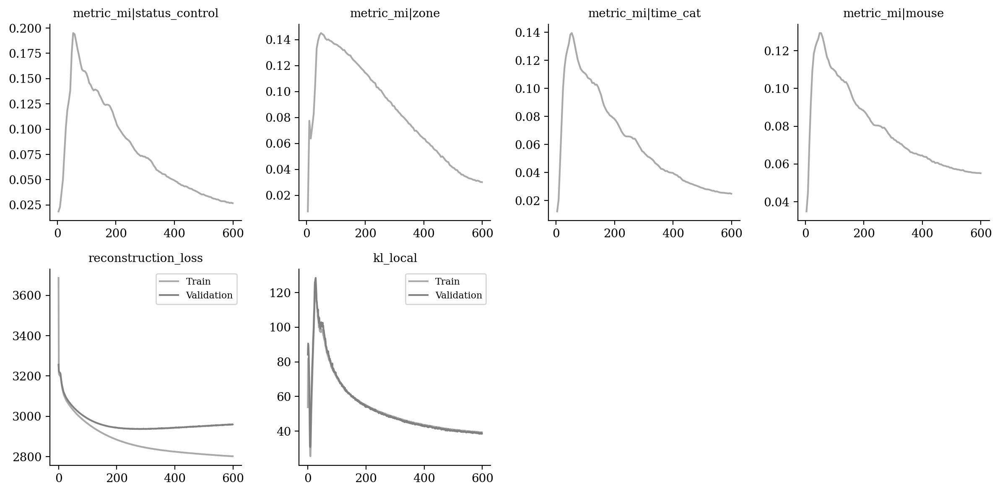

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

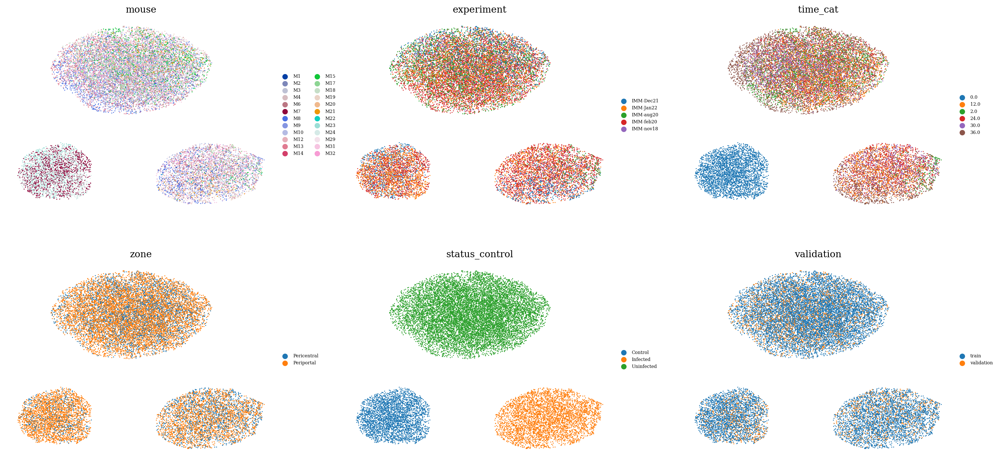

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

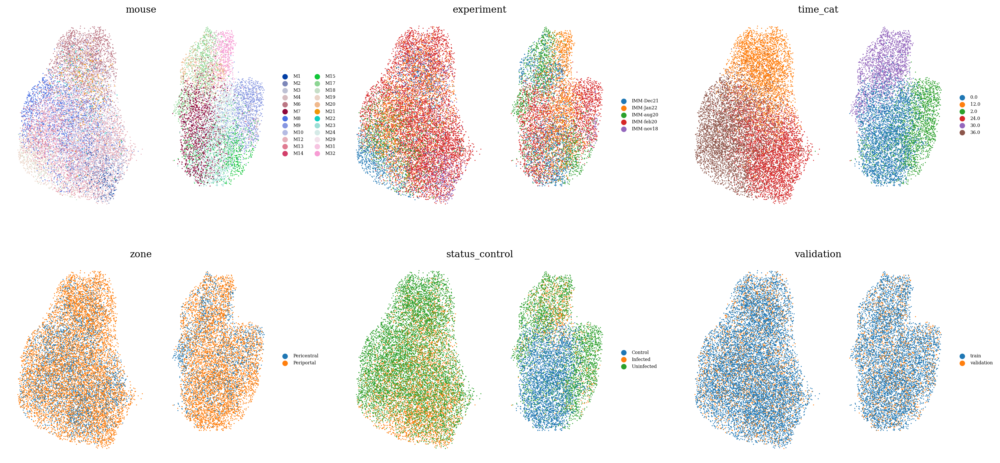

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

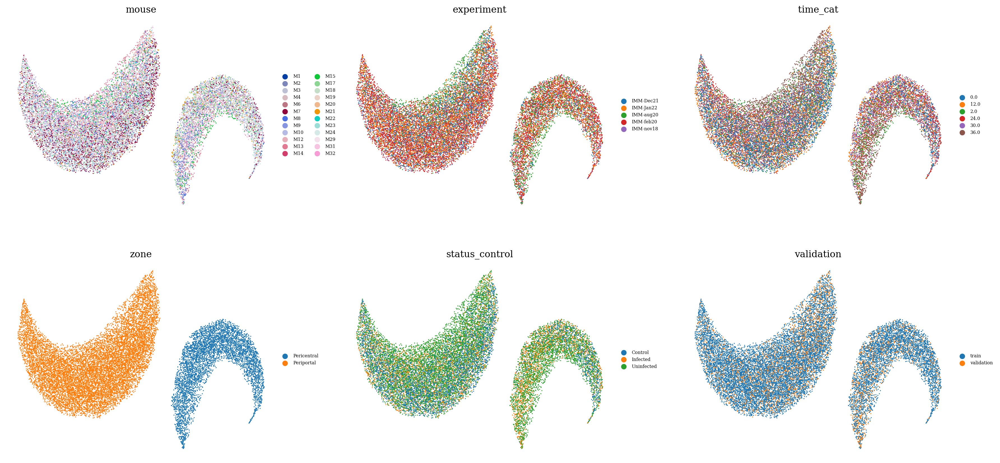

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

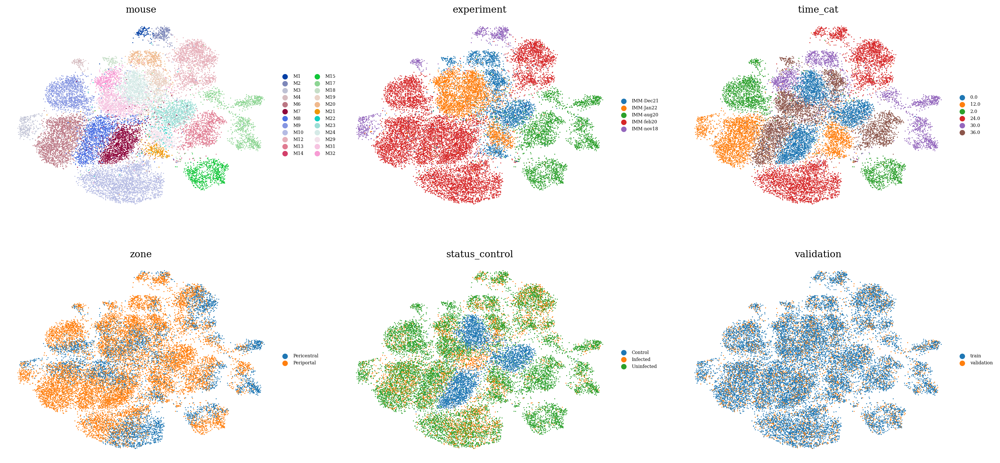

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

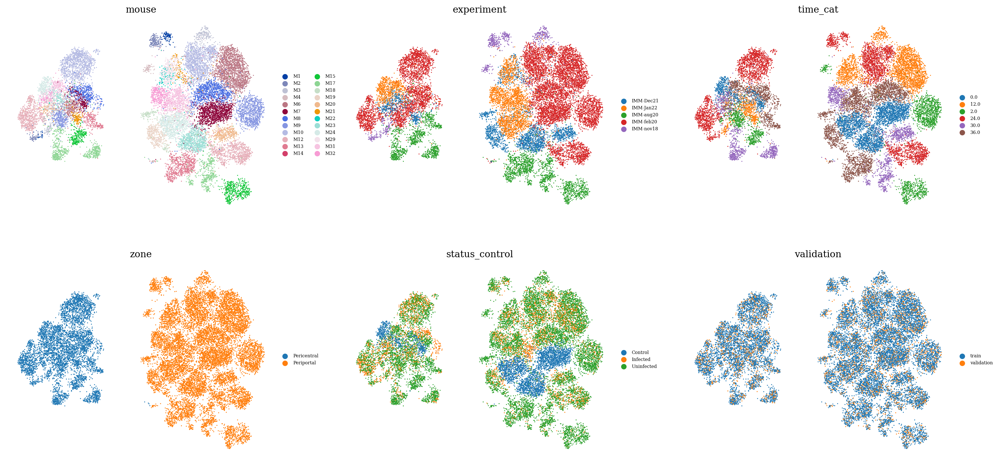

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

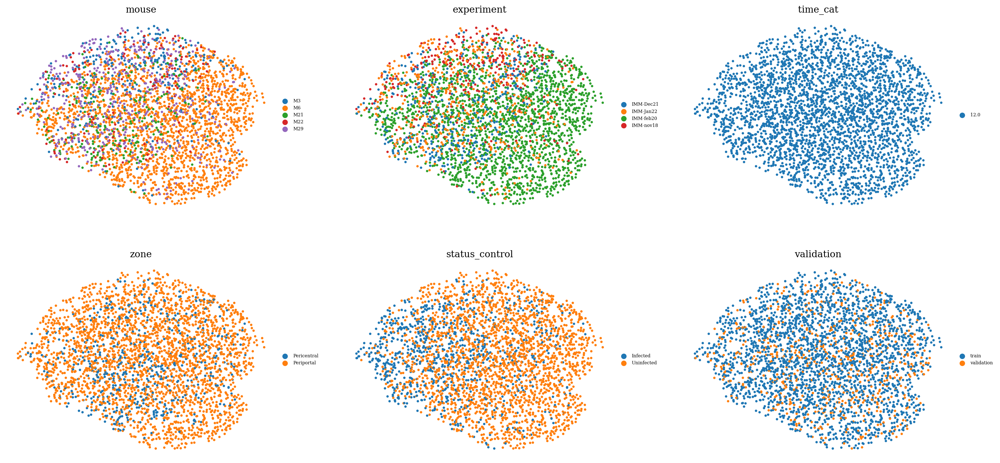

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )